In [ ]:
from netCDF4 import Dataset
import netCDF4 as nc
import numpy as np
import pandas as pd
import datetime
from scipy.stats import gamma
from matplotlib import pyplot as plt
import matplotlib.pyplot as plt
import xarray as xr

In [ ]:
!pip install xgrads
!pip install cartopy
!pip install --no-binary shapely shapely --force

In [ ]:
data=xr.load_dataarray('trmm3b42.daily.precip.indonesia.1998.2015.nc')
data

<xarray.DataArray 'precip' (time: 6574, lat: 122, lon: 242)>
array([[[0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
         1.22399998e+01, 3.54300003e+01, 5.09099998e+01],
        [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
         2.56499996e+01, 3.86399994e+01, 5.10900002e+01],
        [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
         1.82999992e+01, 2.69099998e+01, 5.00099983e+01],
        ...,
        [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
         9.30000007e-01, 9.90000010e-01, 5.39999962e-01],
        [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
         2.06999993e+00, 1.31999993e+00, 8.99999976e-01],
        [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
         3.59999985e-01, 2.69999981e-01, 2.99999993e-02]],

       [[0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
         1.54200001e+01, 2.05200005e+01, 2.89200001e+01],
        [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
         1.40400000e+01, 1.99200001e+01, 3.53699989e+01],
        [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
         1.27799997e+01, 1.71899986e+01, 2.57099991e+01],
...
        [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
         0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
        [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
         0.00000000e+00, 0.00000000e+00, 3.29999983e-01],
        [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
         3.29999983e-01, 1.46999991e+00, 9.89999950e-01]],

       [[3.11999989e+00, 2.57999992e+00, 2.45999980e+00, ...,
         0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
        [3.59999990e+00, 2.18999982e+00, 2.33999991e+00, ...,
         0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
        [3.08999991e+00, 2.06999993e+00, 1.86000001e+00, ...,
         0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
        ...,
        [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
         0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
        [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
         0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
        [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
         0.00000000e+00, 0.00000000e+00, 0.00000000e+00]]])
Coordinates:
  * lon      (lon) float64 89.88 90.12 90.38 90.62 ... 149.4 149.6 149.9 150.1
  * lat      (lat) float64 -15.12 -14.88 -14.62 -14.38 ... 14.62 14.88 15.12
  * time     (time) datetime64[ns] 1998-01-01 1998-01-02 ... 2015-12-31

In [ ]:
data.data[data.data<0.5]=np.nan

In [ ]:
data['lat']

<xarray.DataArray 'lat' (lat: 122)>
array([-15.125, -14.875, -14.625, -14.375, -14.125, -13.875, -13.625, -13.375,
       -13.125, -12.875, -12.625, -12.375, -12.125, -11.875, -11.625, -11.375,
       -11.125, -10.875, -10.625, -10.375, -10.125,  -9.875,  -9.625,  -9.375,
        -9.125,  -8.875,  -8.625,  -8.375,  -8.125,  -7.875,  -7.625,  -7.375,
        -7.125,  -6.875,  -6.625,  -6.375,  -6.125,  -5.875,  -5.625,  -5.375,
        -5.125,  -4.875,  -4.625,  -4.375,  -4.125,  -3.875,  -3.625,  -3.375,
        -3.125,  -2.875,  -2.625,  -2.375,  -2.125,  -1.875,  -1.625,  -1.375,
        -1.125,  -0.875,  -0.625,  -0.375,  -0.125,   0.125,   0.375,   0.625,
         0.875,   1.125,   1.375,   1.625,   1.875,   2.125,   2.375,   2.625,
         2.875,   3.125,   3.375,   3.625,   3.875,   4.125,   4.375,   4.625,
         4.875,   5.125,   5.375,   5.625,   5.875,   6.125,   6.375,   6.625,
         6.875,   7.125,   7.375,   7.625,   7.875,   8.125,   8.375,   8.625,
         8.875,   9.125,   9.375,   9.625,   9.875,  10.125,  10.375,  10.625,
        10.875,  11.125,  11.375,  11.625,  11.875,  12.125,  12.375,  12.625,
        12.875,  13.125,  13.375,  13.625,  13.875,  14.125,  14.375,  14.625,
        14.875,  15.125])
Coordinates:
  * lat      (lat) float64 -15.12 -14.88 -14.62 -14.38 ... 14.62 14.88 15.12
Attributes:
    units:      degrees_north
    long_name:  Latitude

# **Precip**

In [ ]:
Indonesia=data.sel(lon=slice(95,141),lat=slice(-11.25,11.125))
Indonesia

<xarray.DataArray 'precip' (time: 6574, lat: 90, lon: 184)>
array([[[        nan,         nan,         nan, ...,         nan,
                 nan,         nan],
        [        nan,         nan,         nan, ...,         nan,
          1.25999999,  1.07999992],
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan],
        ...,
        [        nan,         nan,         nan, ...,  1.79999995,
          1.67999995,  1.61999989],
        [        nan,         nan,         nan, ...,  2.54999995,
          2.00999999,  3.18000007],
        [        nan,         nan,         nan, ...,  2.0999999 ,
          1.98000002,  2.6099999 ]],

       [[        nan,         nan,         nan, ...,  4.5       ,
          5.06999969,  1.28999996],
        [        nan,         nan,         nan, ...,  3.9599998 ,
          3.80999994,  3.83999991],
        [        nan,         nan,         nan, ...,  1.13999999,
          2.63999987,  1.8599999 ],
...
        [        nan,         nan,         nan, ...,  2.27999997,
          1.61999989,  1.04999995],
        [        nan,         nan,         nan, ...,  2.27999997,
          1.28999996,  0.89999998],
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan]],

       [[25.37999916, 26.18999863, 31.8599987 , ...,         nan,
                 nan,         nan],
        [13.73999977, 17.18999863, 27.32999992, ...,         nan,
                 nan,         nan],
        [26.90999985, 11.97000027, 18.56999969, ...,         nan,
                 nan,         nan],
        ...,
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan],
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan],
        [        nan,         nan,         nan, ...,         nan,
                 nan,         nan]]])
Coordinates:
  * lon      (lon) float64 95.12 95.38 95.62 95.88 ... 140.1 140.4 140.6 140.9
  * lat      (lat) float64 -11.12 -10.88 -10.62 -10.38 ... 10.62 10.88 11.12
  * time     (time) datetime64[ns] 1998-01-01 1998-01-02 ... 2015-12-31

In [ ]:
import scipy.stats as st

# **Januari**

In [ ]:
PROB05_20=np.zeros((90,184))
PROB20_50=np.zeros((90,184))
PROB50_100=np.zeros((90,184))
PROB100_150=np.zeros((90,184))
PROB150=np.zeros((90,184))

for iy in (range(0,90)):
  for ix in range (0,184):
    TS=Indonesia[:,iy,ix] 
    TS=TS.groupby('time.month') 
    for imon in range(1,2): 
      TSmon=TS[imon].dropna('time') 
      gampar=st.gamma.fit(TSmon.data[TSmon.data<80])
      #probabilitas 0.5<CH<20
      a=st.gamma.cdf(20,*gampar) - st.gamma.cdf(0.5,*gampar)
      PROB05_20[iy,ix]=a
      #probabilitas 20<CH<50
      b=st.gamma.cdf(50,*gampar)-st.gamma.cdf(20,*gampar)
      PROB20_50[iy,ix]=b
      #prob 50<CH<100
      c=st.gamma.cdf(100,*gampar)-st.gamma.cdf(50,*gampar)
      PROB50_100[iy,ix]=c
      #prob 100<CH<150
      d=st.gamma.cdf(150,*gampar)-st.gamma.cdf(100,*gampar)
      PROB100_150[iy,ix]=d
      #prob CH >150
      e= 1-st.gamma.cdf(150,*gampar)
      PROB150[iy,ix]=e

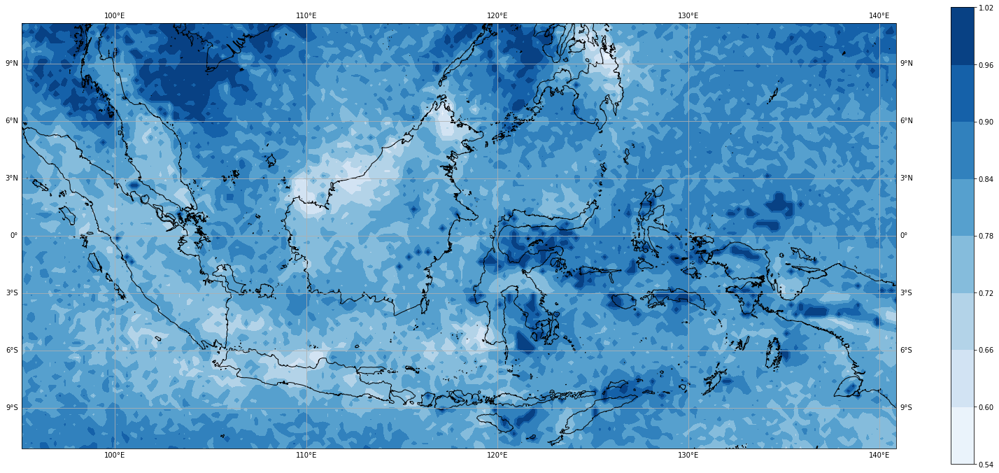

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,PROB05_20,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

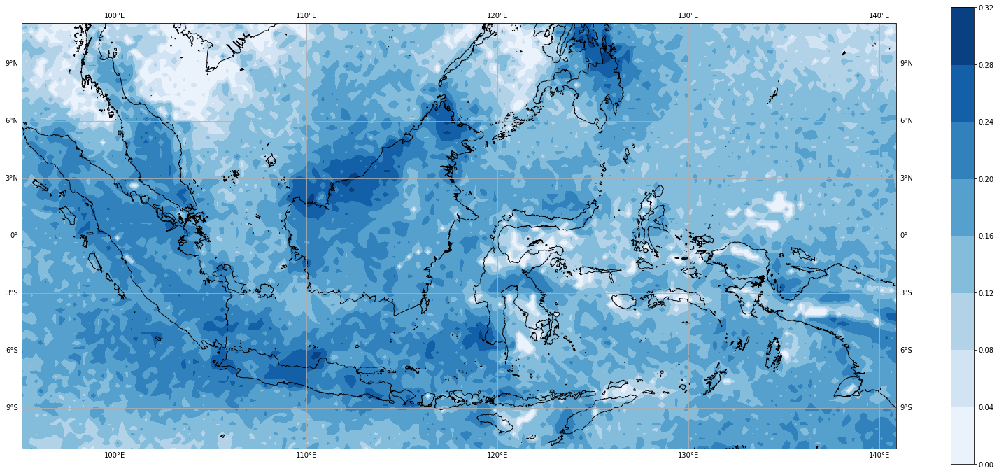

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,PROB20_50,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

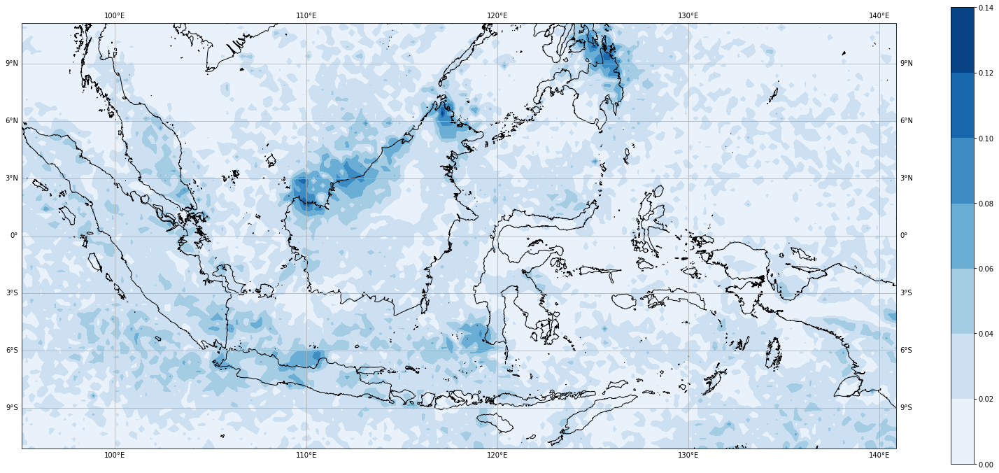

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,PROB50_100,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

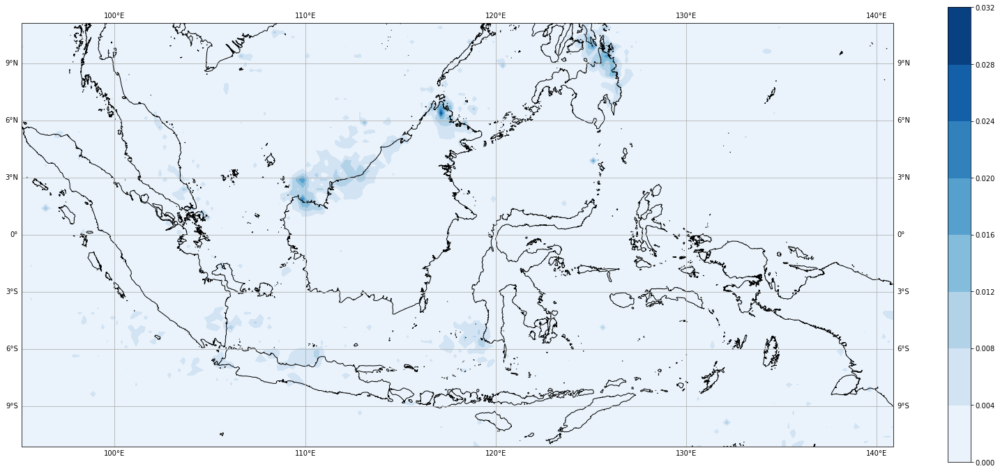

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,PROB100_150,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

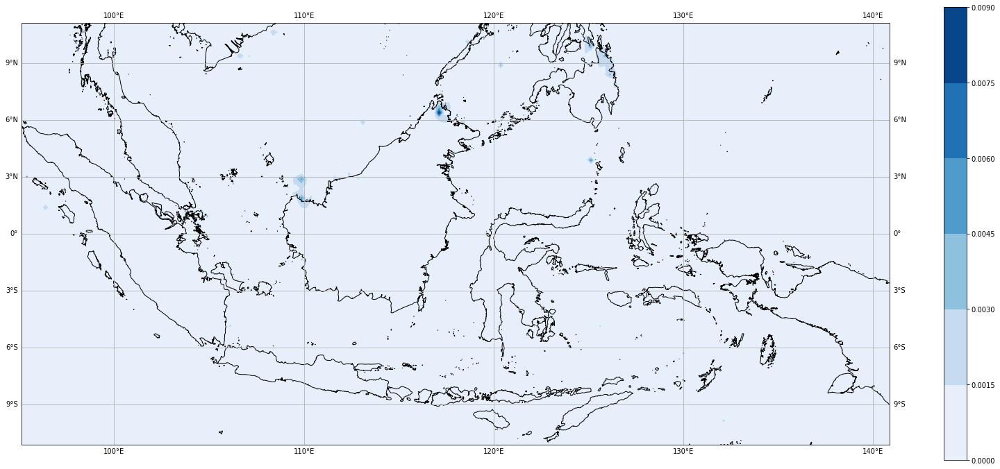

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,PROB150,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

# **Februari**

In [ ]:
FEB05_20=np.zeros((90,184))
FEB20_50=np.zeros((90,184))
FEB50_100=np.zeros((90,184))
FEB100_150=np.zeros((90,184))
FEB150=np.zeros((90,184))

for iy in (range(0,90)):
  for ix in range (0,184):
    TS=Indonesia[:,iy,ix] 
    TS=TS.groupby('time.month') 
    for imon in range(2,3): 
      TSmon=TS[imon].dropna('time') 
      gampar=st.gamma.fit(TSmon.data[TSmon.data<80])
      #probabilitas 0.5<CH<20
      f=st.gamma.cdf(20,*gampar) - st.gamma.cdf(0.5,*gampar)
      FEB05_20[iy,ix]=f
      #probabilitas 20<CH<50
      g=st.gamma.cdf(50,*gampar)-st.gamma.cdf(20,*gampar)
      FEB20_50[iy,ix]=g
      #prob 50<CH<100
      h=st.gamma.cdf(100,*gampar)-st.gamma.cdf(50,*gampar)
      FEB50_100[iy,ix]=h
      #prob 100<CH<150
      i=st.gamma.cdf(150,*gampar)-st.gamma.cdf(100,*gampar)
      FEB100_150[iy,ix]=i
      #prob CH >150
      j= 1-st.gamma.cdf(150,*gampar)
      FEB150[iy,ix]=j

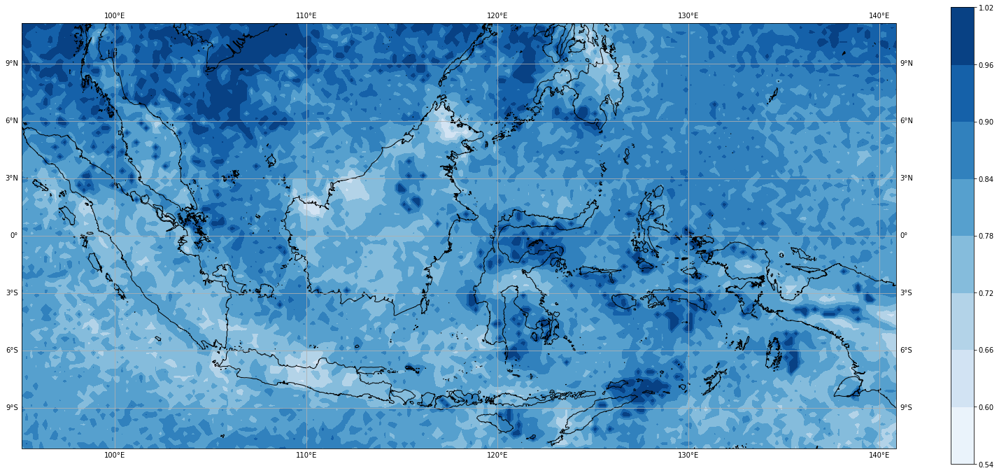

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,FEB05_20,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

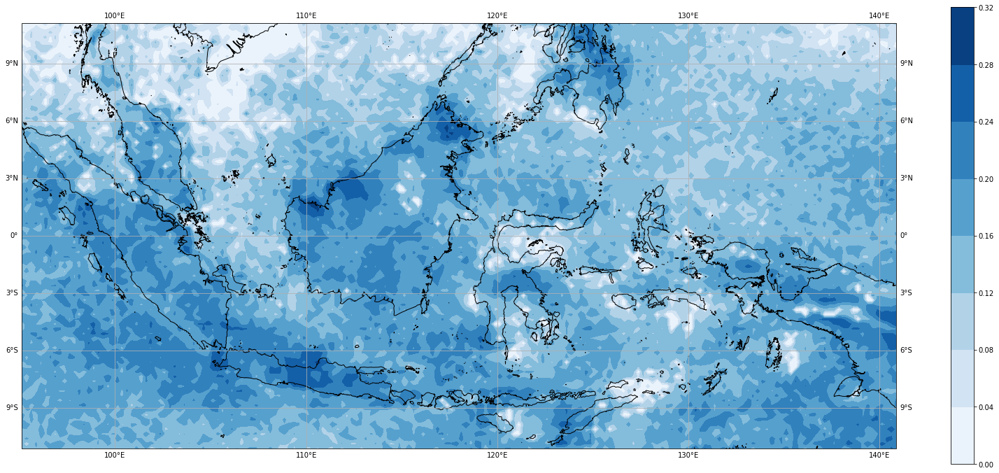

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,FEB20_50,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

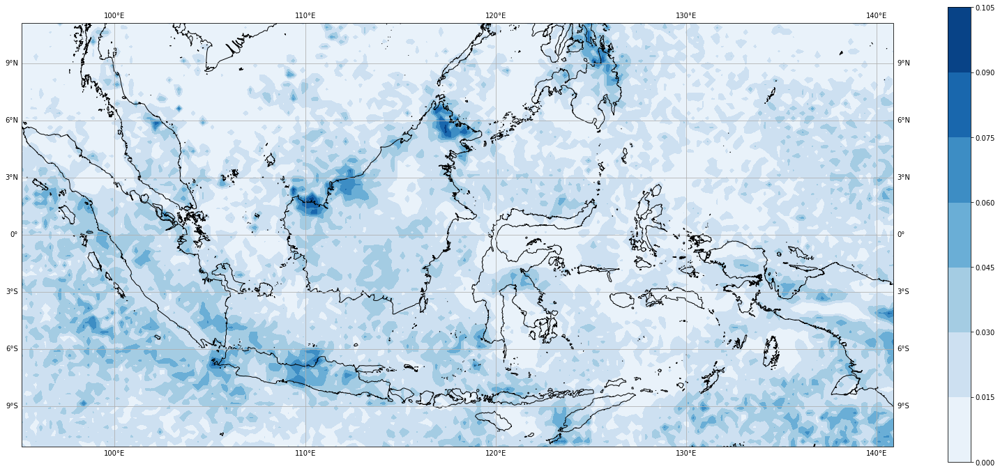

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,FEB50_100,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

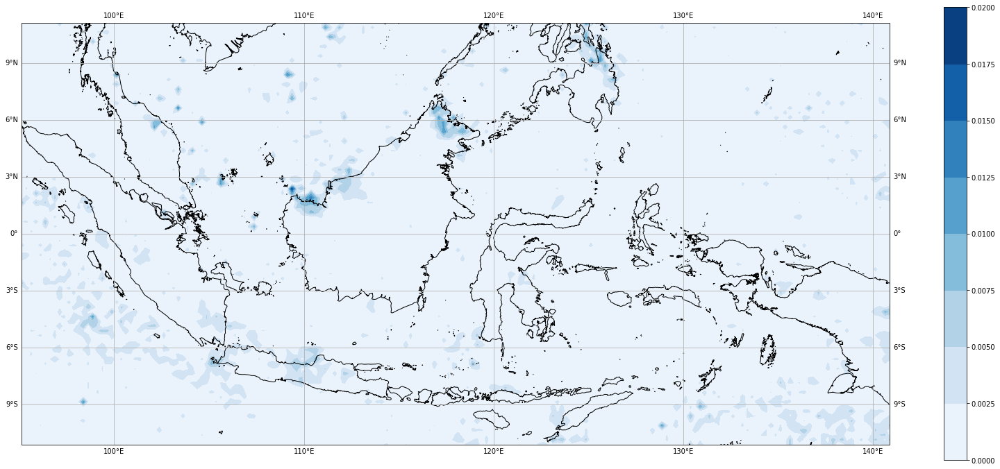

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,FEB100_150,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

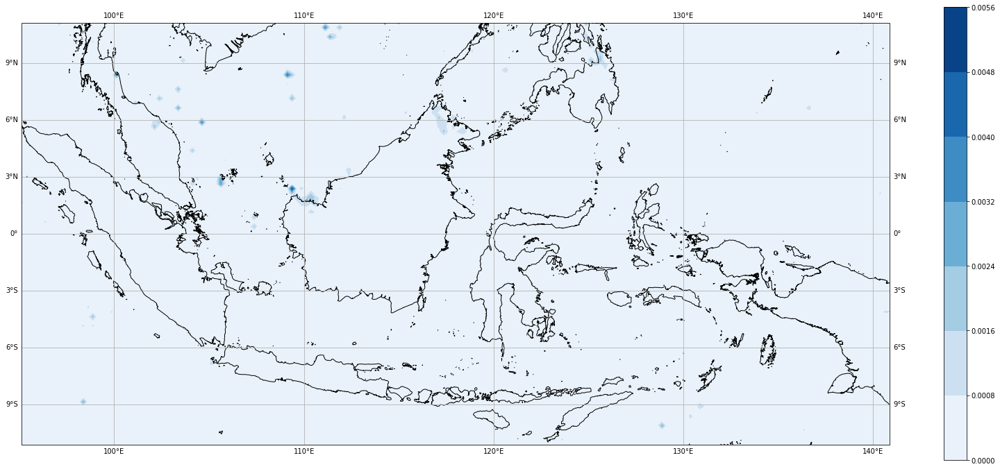

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,FEB150,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

# **Maret**

In [ ]:
MAR05_20=np.zeros((90,184))
MAR20_50=np.zeros((90,184))
MAR50_100=np.zeros((90,184))
MAR100_150=np.zeros((90,184))
MAR150=np.zeros((90,184))

for iy in (range(0,90)):
  for ix in range (0,184):
    TS=Indonesia[:,iy,ix] 
    TS=TS.groupby('time.month') 
    for imon in range(3,4): 
      TSmon=TS[imon].dropna('time') 
      gampar=st.gamma.fit(TSmon.data[TSmon.data<80])
      #probabilitas 0.5<CH<20
      k=st.gamma.cdf(20,*gampar) - st.gamma.cdf(0.5,*gampar)
      MAR05_20[iy,ix]=k
      #probabilitas 20<CH<50
      l=st.gamma.cdf(50,*gampar)-st.gamma.cdf(20,*gampar)
      MAR20_50[iy,ix]=l
      #prob 50<CH<100
      m=st.gamma.cdf(100,*gampar)-st.gamma.cdf(50,*gampar)
      MAR50_100[iy,ix]=m
      #prob 100<CH<150
      n=st.gamma.cdf(150,*gampar)-st.gamma.cdf(100,*gampar)
      MAR100_150[iy,ix]=n
      #prob CH >150
      o= 1-st.gamma.cdf(150,*gampar)
      MAR150[iy,ix]=o

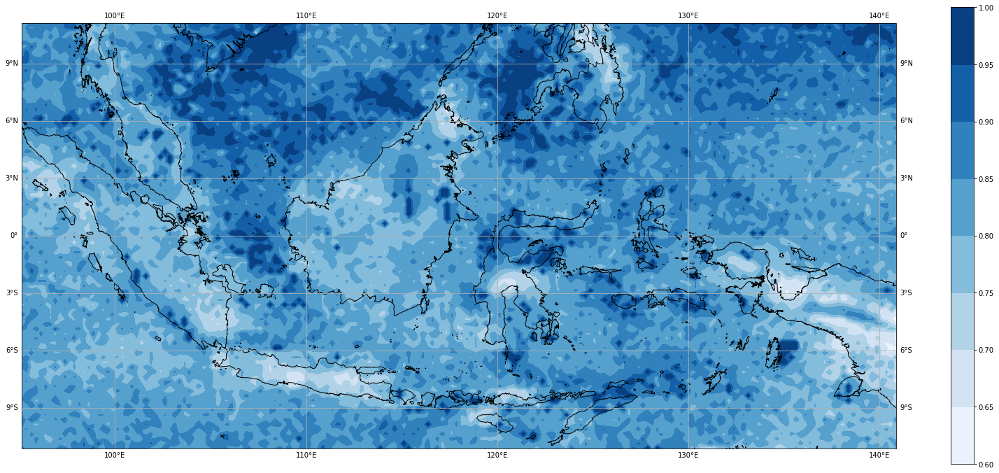

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,MAR05_20,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

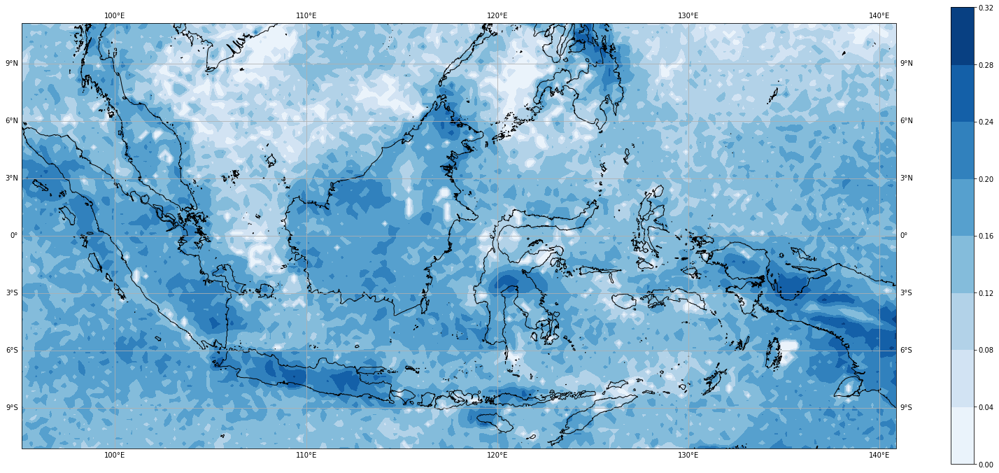

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,MAR20_50,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

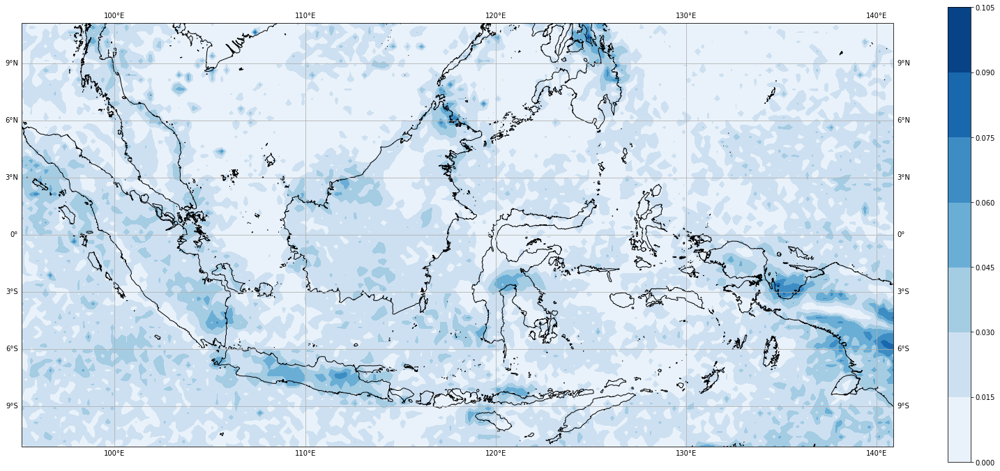

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,MAR50_100,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

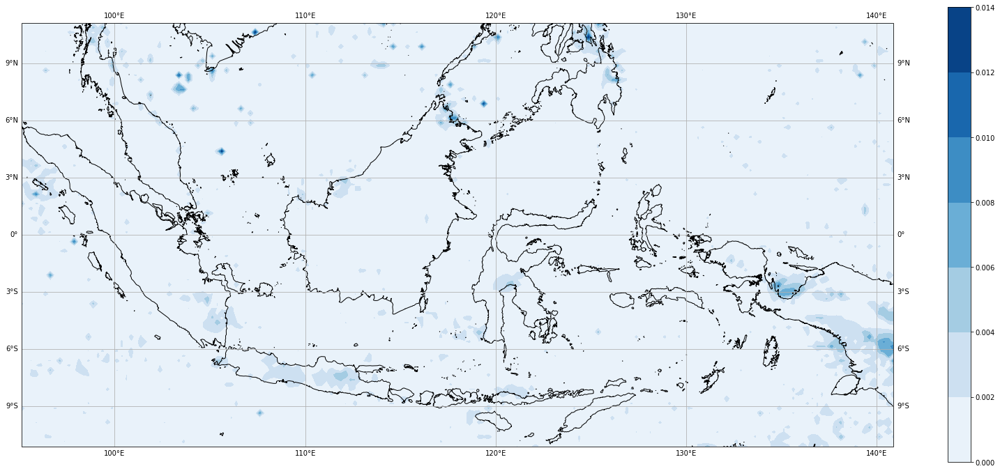

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,MAR100_150,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

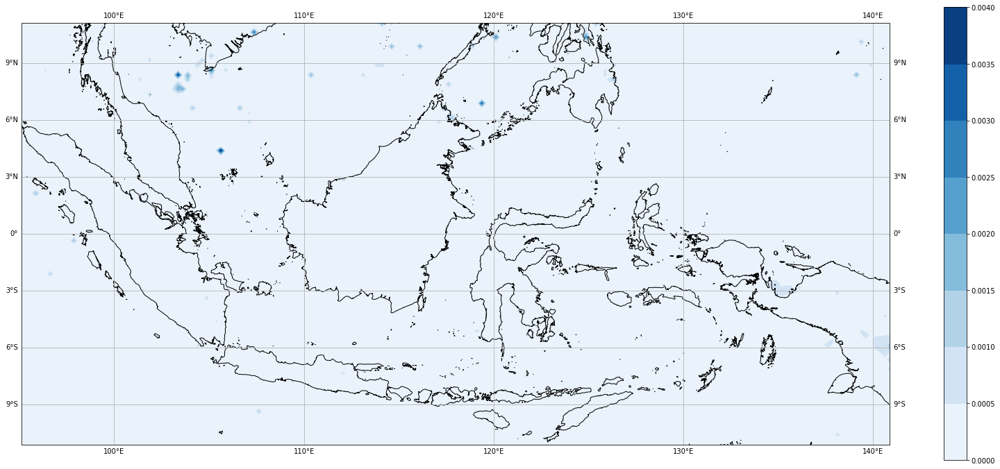

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,MAR150,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

# **April**

In [ ]:
APR05_20=np.zeros((90,184))
APR20_50=np.zeros((90,184))
APR50_100=np.zeros((90,184))
APR100_150=np.zeros((90,184))
APR150=np.zeros((90,184))

for iy in (range(0,90)):
  for ix in range (0,184):
    TS=Indonesia[:,iy,ix] 
    TS=TS.groupby('time.month') 
    for imon in range(4,5): 
      TSmon=TS[imon].dropna('time') 
      gampar=st.gamma.fit(TSmon.data[TSmon.data<80])
      #probabilitas 0.5<CH<20
      p=st.gamma.cdf(20,*gampar) - st.gamma.cdf(0.5,*gampar)
      APR05_20[iy,ix]=p
      #probabilitas 20<CH<50
      q=st.gamma.cdf(50,*gampar)-st.gamma.cdf(20,*gampar)
      APR20_50[iy,ix]=q
      #prob 50<CH<100
      r=st.gamma.cdf(100,*gampar)-st.gamma.cdf(50,*gampar)
      APR50_100[iy,ix]=r
      #prob 100<CH<150
      s=st.gamma.cdf(150,*gampar)-st.gamma.cdf(100,*gampar)
      APR100_150[iy,ix]=s
      #prob CH >150
      t= 1-st.gamma.cdf(150,*gampar)
      APR150[iy,ix]=t

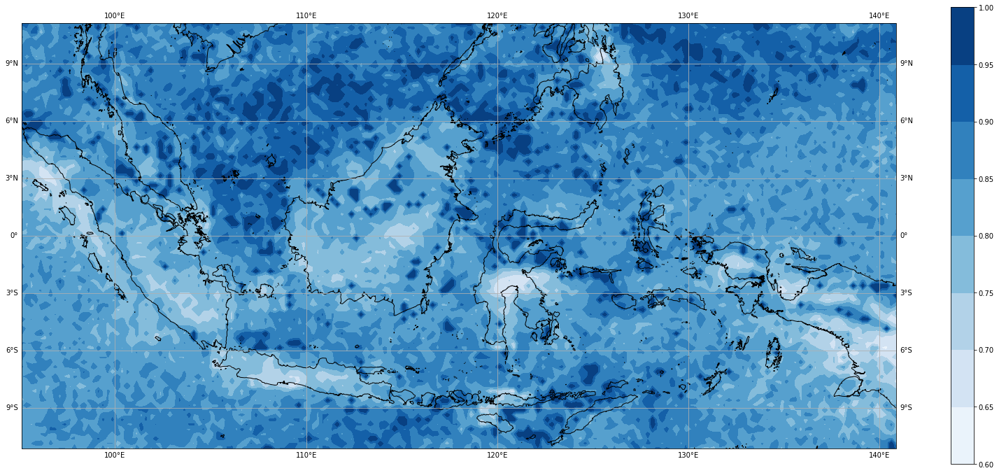

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,APR05_20,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

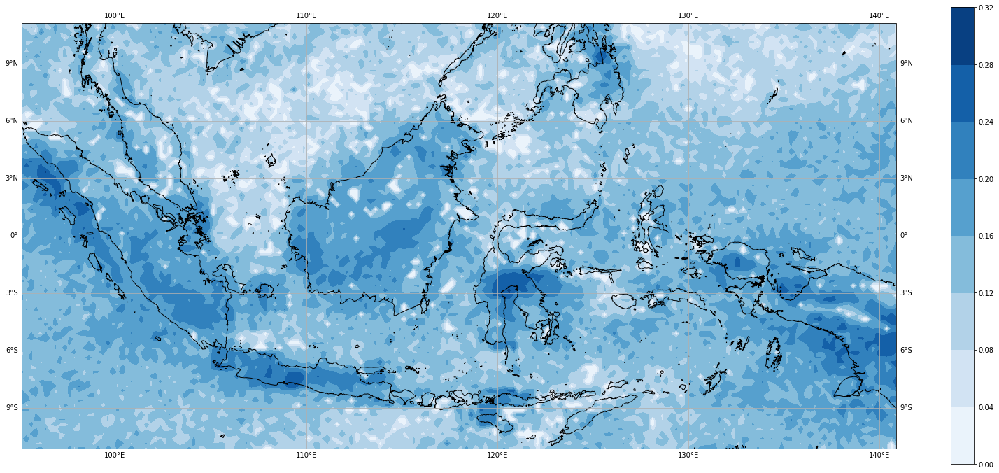

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,APR20_50,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

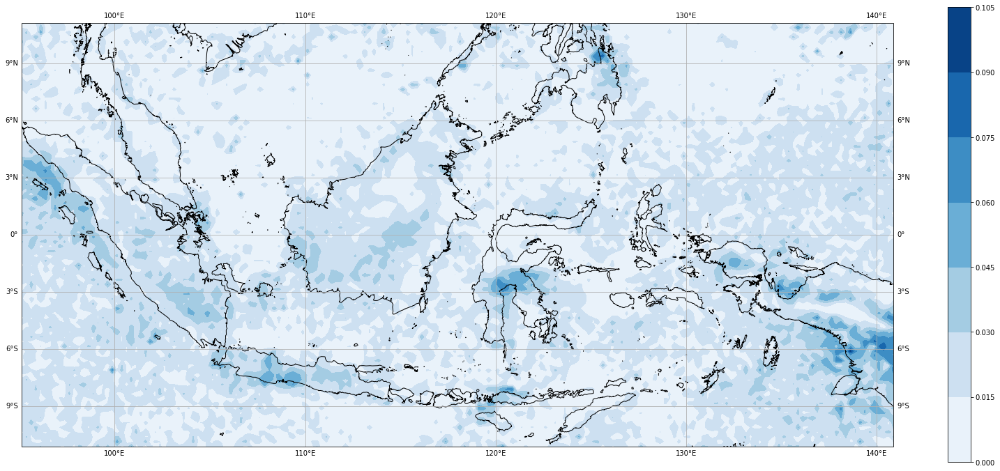

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,APR50_100,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

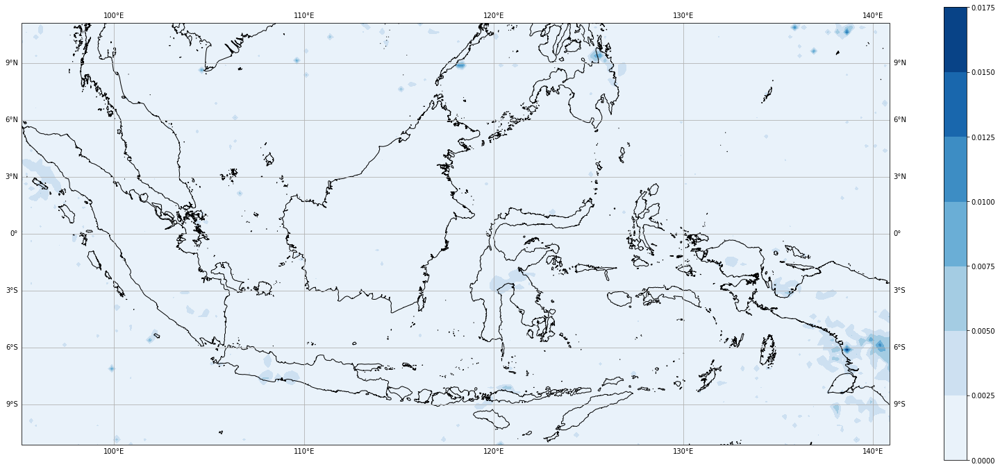

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,APR100_150,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

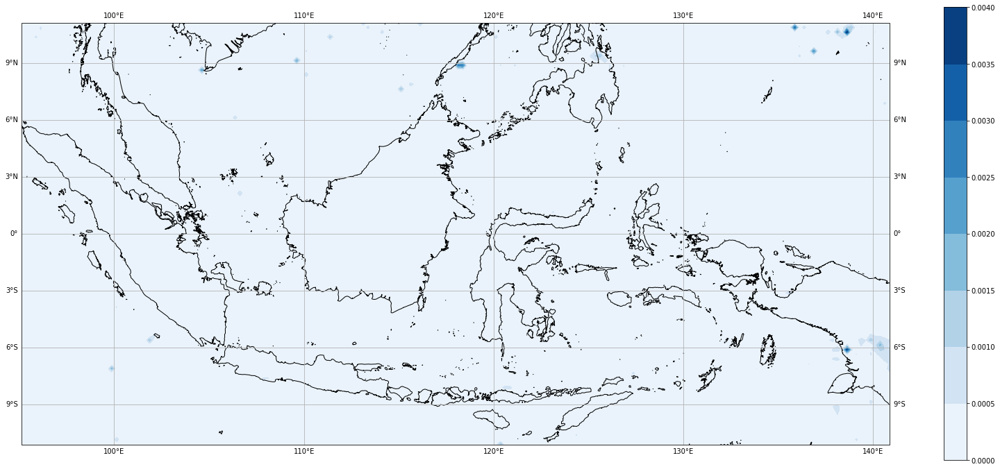

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,APR150,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

# **MEI**

In [ ]:
MEI05_20=np.zeros((90,184))
MEI20_50=np.zeros((90,184))
MEI50_100=np.zeros((90,184))
MEI100_150=np.zeros((90,184))
MEI150=np.zeros((90,184))

for iy in (range(0,90)):
  for ix in range (0,184):
    TS=Indonesia[:,iy,ix] 
    TS=TS.groupby('time.month') 
    for imon in range(5,6): 
      TSmon=TS[imon].dropna('time') 
      gampar=st.gamma.fit(TSmon.data[TSmon.data<80])
      #probabilitas 0.5<CH<20
      u=st.gamma.cdf(20,*gampar) - st.gamma.cdf(0.5,*gampar)
      MEI05_20[iy,ix]=u
      #probabilitas 20<CH<50
      v=st.gamma.cdf(50,*gampar)-st.gamma.cdf(20,*gampar)
      MEI20_50[iy,ix]=v
      #prob 50<CH<100
      w=st.gamma.cdf(100,*gampar)-st.gamma.cdf(50,*gampar)
      MEI50_100[iy,ix]=w
      #prob 100<CH<150
      x=st.gamma.cdf(150,*gampar)-st.gamma.cdf(100,*gampar)
      MEI100_150[iy,ix]=x
      #prob CH >150
      y= 1-st.gamma.cdf(150,*gampar)
      MEI150[iy,ix]=y

/usr/local/lib/python3.7/dist-packages/cartopy/io/__init__.py:241: DownloadWarning: Downloading: https://www.ngdc.noaa.gov/mgg/shorelines/data/gshhs/oldversions/version2.2.0/GSHHS_shp_2.2.0.zip
  warnings.warn('Downloading: {}'.format(url), DownloadWarning)
/usr/local/lib/python3.7/dist-packages/shapefile.py:391: UserWarning: Shapefile shape has invalid polygon: no exterior rings found (must have clockwise orientation); interpreting holes as exteriors.
  warnings.warn('Shapefile shape has invalid polygon: no exterior rings found (must have clockwise orientation); interpreting holes as exteriors.')


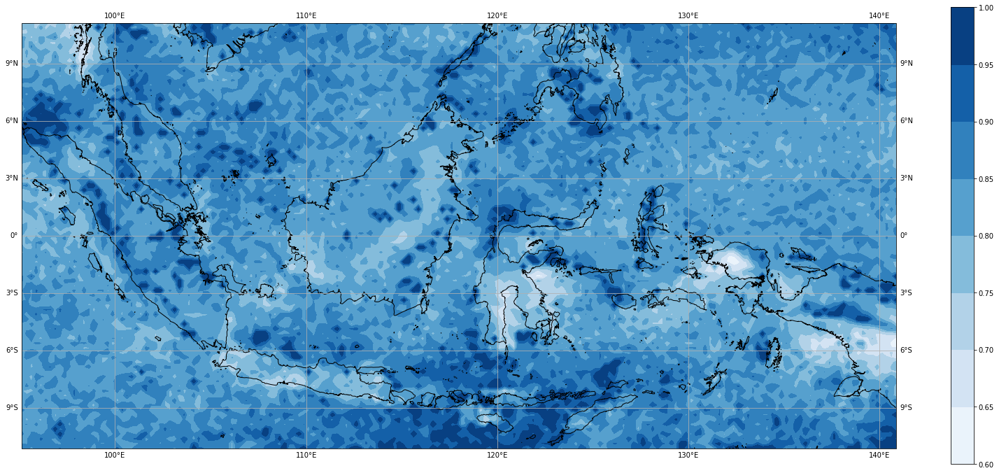

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,MEI05_20,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

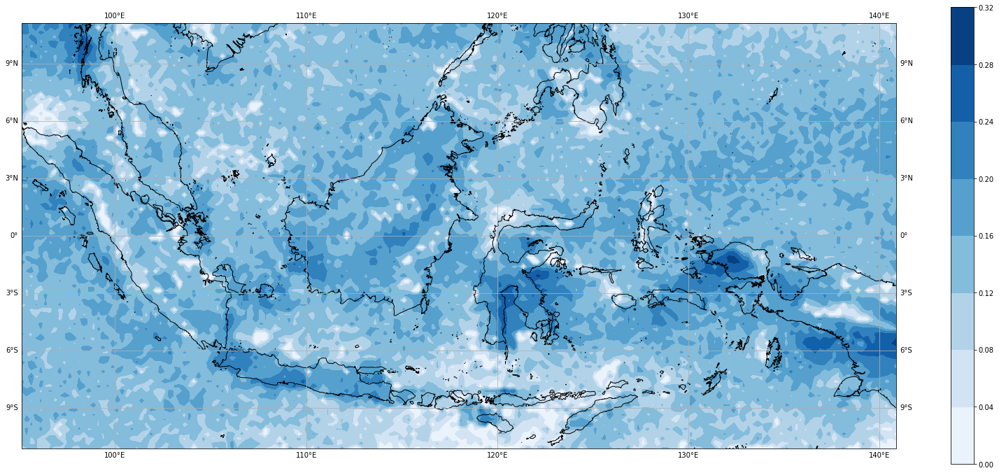

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,MEI20_50,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

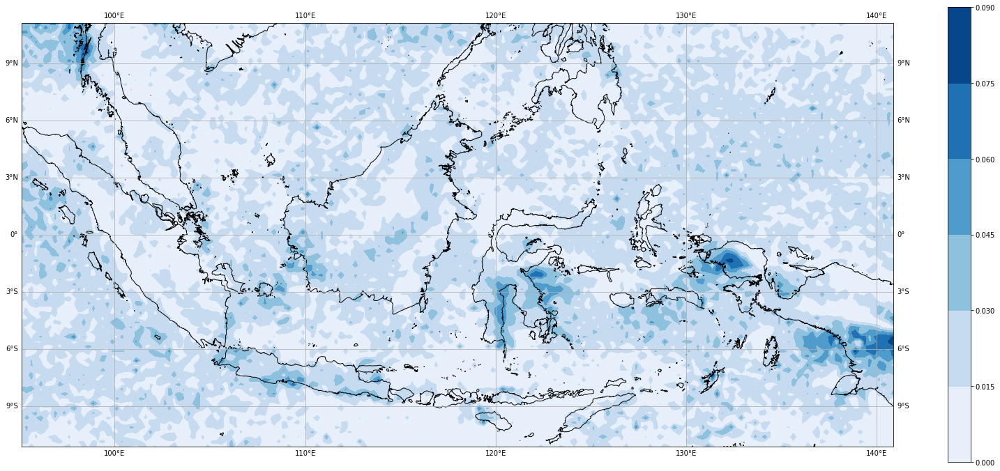

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,MEI50_100,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

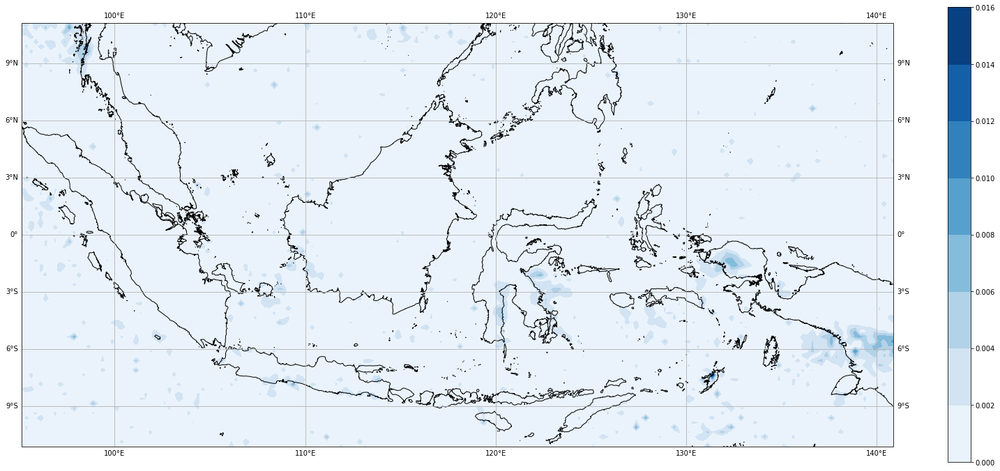

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,MEI100_150,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

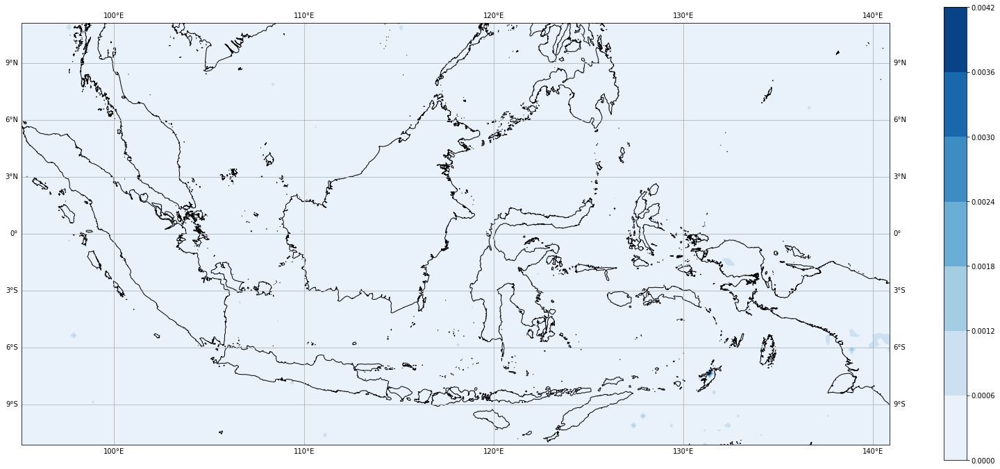

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,MEI150,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

# **Juni**

In [ ]:
JUN05_20=np.zeros((90,184))
JUN20_50=np.zeros((90,184))
JUN50_100=np.zeros((90,184))
JUN100_150=np.zeros((90,184))
JUN150=np.zeros((90,184))

for iy in (range(0,90)):
  for ix in range (0,184):
    TS=Indonesia[:,iy,ix] 
    TS=TS.groupby('time.month') 
    for imon in range(6,7): 
      TSmon=TS[imon].dropna('time') 
      gampar=st.gamma.fit(TSmon.data[TSmon.data<80])
      #probabilitas 0.5<CH<20
      z=st.gamma.cdf(20,*gampar) - st.gamma.cdf(0.5,*gampar)
      JUN05_20[iy,ix]=z
      #probabilitas 20<CH<50
      aa=st.gamma.cdf(50,*gampar)-st.gamma.cdf(20,*gampar)
      JUN20_50[iy,ix]=aa
      #prob 50<CH<100
      ab=st.gamma.cdf(100,*gampar)-st.gamma.cdf(50,*gampar)
      JUN50_100[iy,ix]=ab
      #prob 100<CH<150
      ac=st.gamma.cdf(150,*gampar)-st.gamma.cdf(100,*gampar)
      JUN100_150[iy,ix]=ac
      #prob CH >150
      ad= 1-st.gamma.cdf(150,*gampar)
      JUN150[iy,ix]=ad

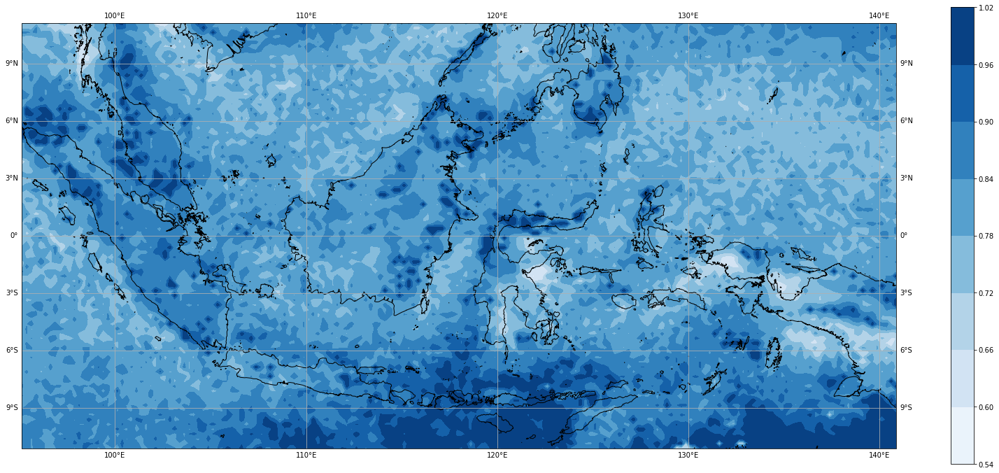

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,JUN05_20,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

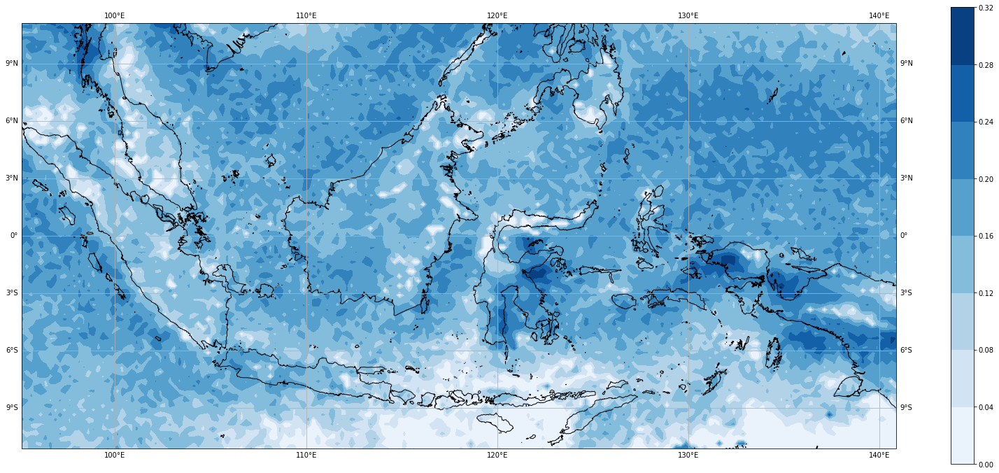

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,JUN20_50,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

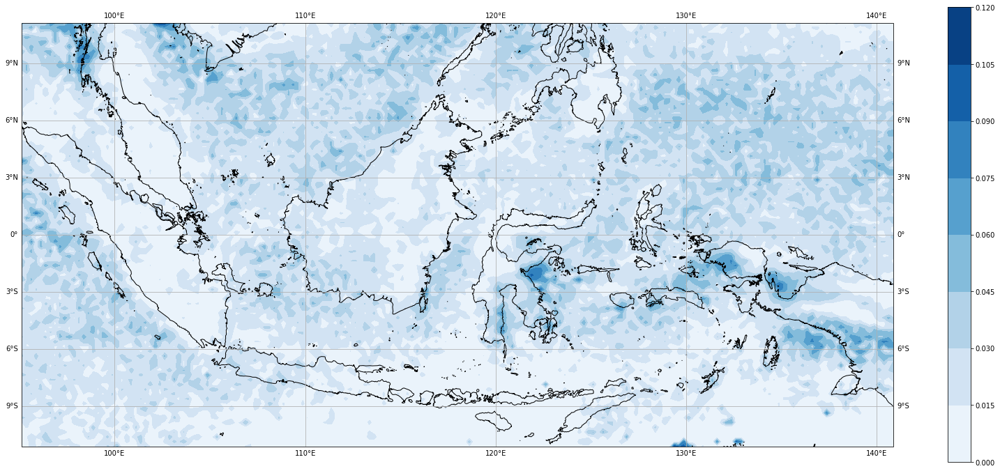

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,JUN50_100,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

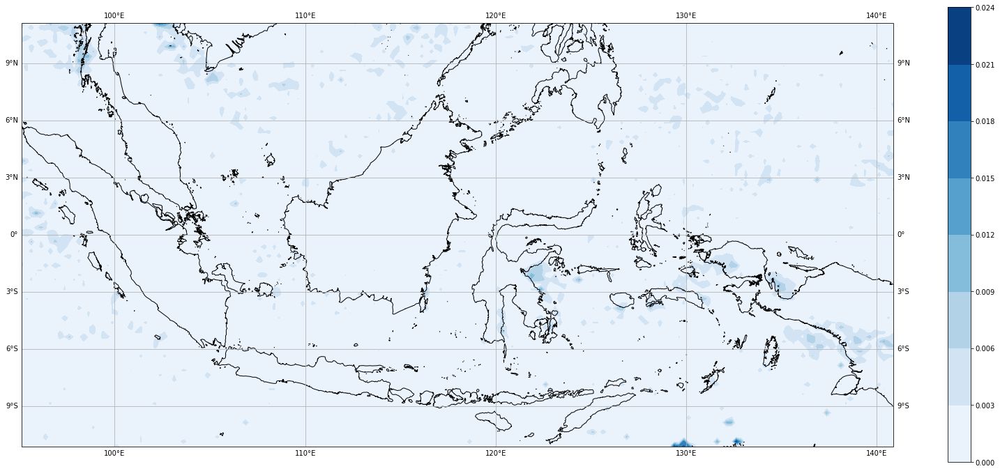

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,JUN100_150,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

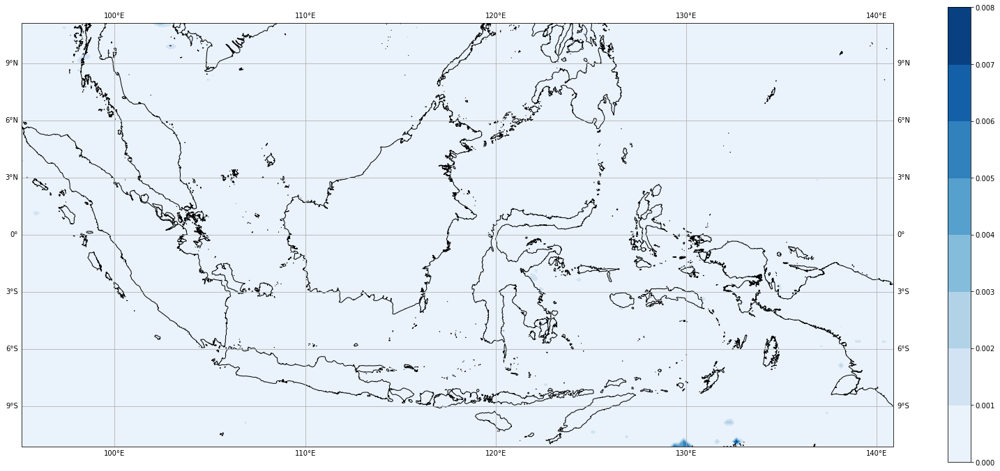

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,JUN150,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

# **Juli**

In [ ]:
JUL05_20=np.zeros((90,184))
JUL20_50=np.zeros((90,184))
JUL50_100=np.zeros((90,184))
JUL100_150=np.zeros((90,184))
JUL150=np.zeros((90,184))

for iy in (range(0,90)):
  for ix in range (0,184):
    TS=Indonesia[:,iy,ix] 
    TS=TS.groupby('time.month') 
    for imon in range(7,8): 
      TSmon=TS[imon].dropna('time') 
      gampar=st.gamma.fit(TSmon.data[TSmon.data<80])
      #probabilitas 0.5<CH<20
      ae=st.gamma.cdf(20,*gampar) - st.gamma.cdf(0.5,*gampar)
      JUL05_20[iy,ix]=ae
      #probabilitas 20<CH<50
      af=st.gamma.cdf(50,*gampar)-st.gamma.cdf(20,*gampar)
      JUL20_50[iy,ix]=af
      #prob 50<CH<100
      ag=st.gamma.cdf(100,*gampar)-st.gamma.cdf(50,*gampar)
      JUL50_100[iy,ix]=ag
      #prob 100<CH<150
      ah=st.gamma.cdf(150,*gampar)-st.gamma.cdf(100,*gampar)
      JUL100_150[iy,ix]=ah
      #prob CH >150
      ai= 1-st.gamma.cdf(150,*gampar)
      JUL150[iy,ix]=ai

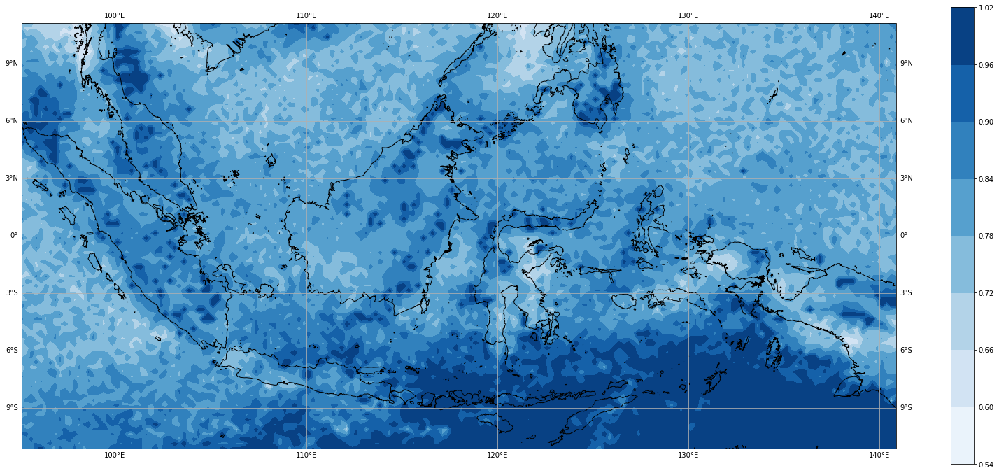

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,JUL05_20,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

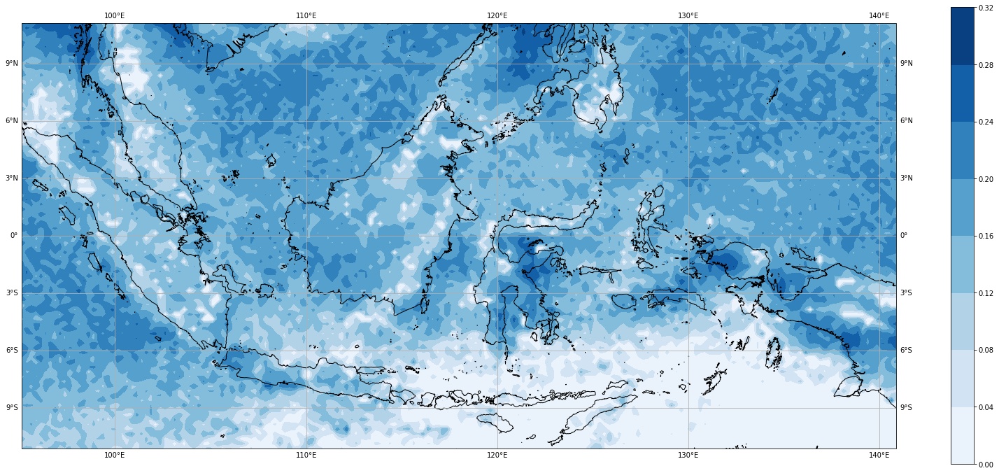

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,JUL20_50,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

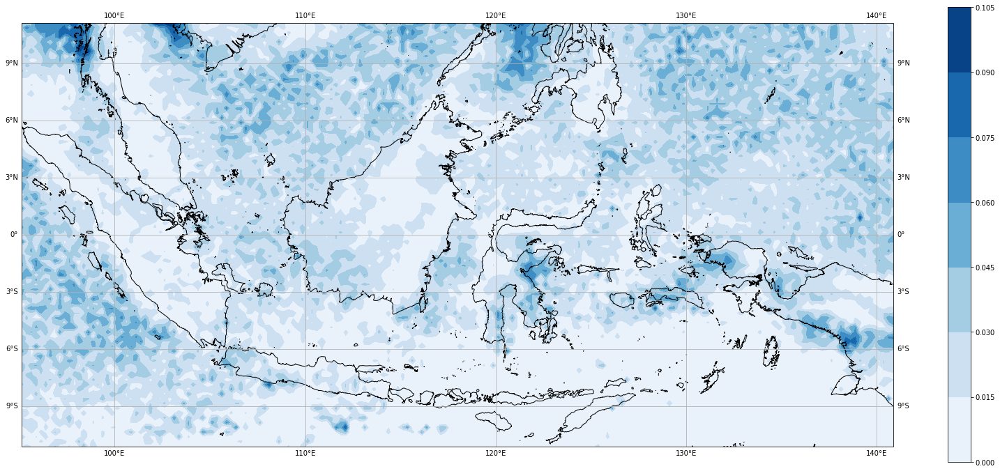

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,JUL50_100,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

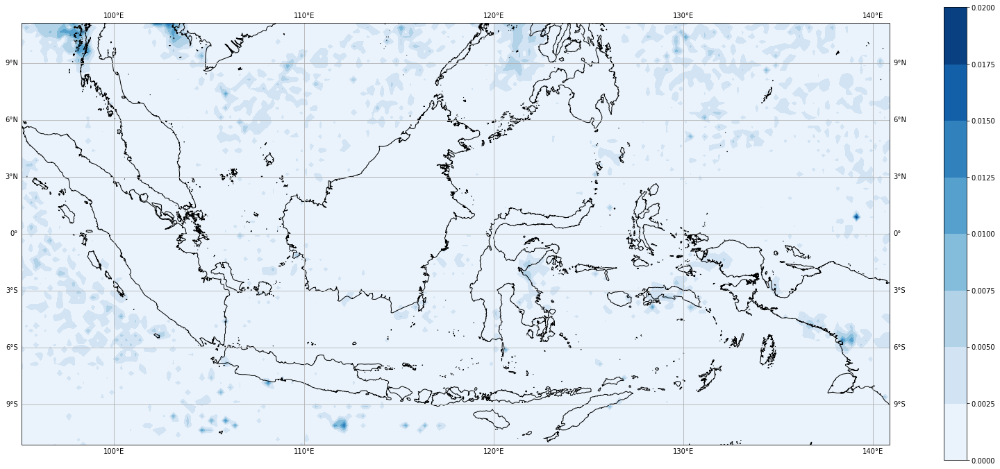

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,JUL100_150,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

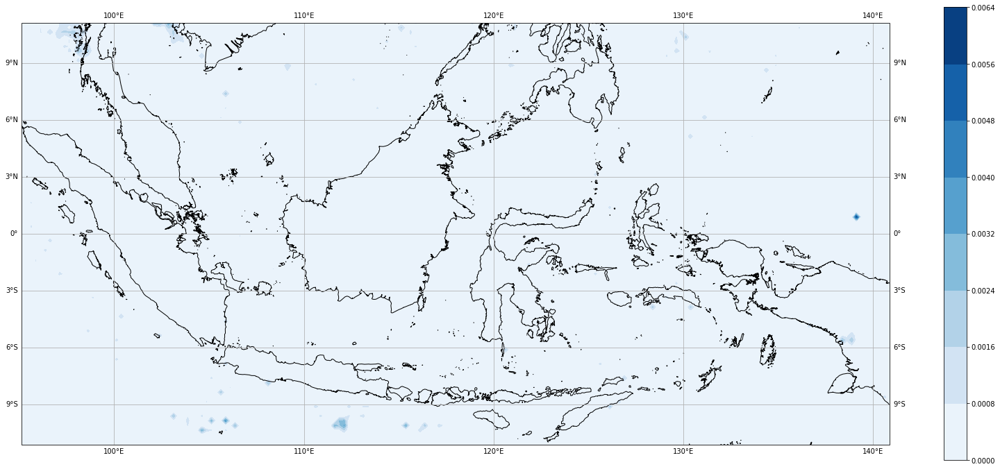

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,JUL150,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

# **Agustus**

In [ ]:
AGU05_20=np.zeros((90,184))
AGU20_50=np.zeros((90,184))
AGU50_100=np.zeros((90,184))
AGU100_150=np.zeros((90,184))
AGU150=np.zeros((90,184))

for iy in (range(0,90)):
  for ix in range (0,184):
    TS=Indonesia[:,iy,ix] 
    TS=TS.groupby('time.month') 
    for imon in range(8,9): 
      TSmon=TS[imon].dropna('time') 
      gampar=st.gamma.fit(TSmon.data[TSmon.data<80])
      #probabilitas 0.5<CH<20
      aj=st.gamma.cdf(20,*gampar) - st.gamma.cdf(0.5,*gampar)
      AGU05_20[iy,ix]=aj
      #probabilitas 20<CH<50
      ak=st.gamma.cdf(50,*gampar)-st.gamma.cdf(20,*gampar)
      AGU20_50[iy,ix]=ak
      #prob 50<CH<100
      al=st.gamma.cdf(100,*gampar)-st.gamma.cdf(50,*gampar)
      AGU50_100[iy,ix]=al
      #prob 100<CH<150
      am=st.gamma.cdf(150,*gampar)-st.gamma.cdf(100,*gampar)
      AGU100_150[iy,ix]=am
      #prob CH >150
      an= 1-st.gamma.cdf(150,*gampar)
      AGU150[iy,ix]=an

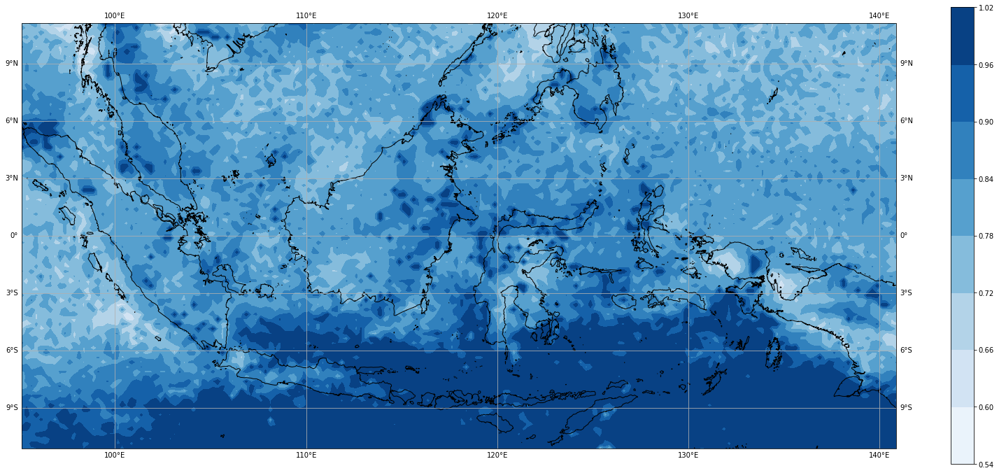

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,AGU05_20,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

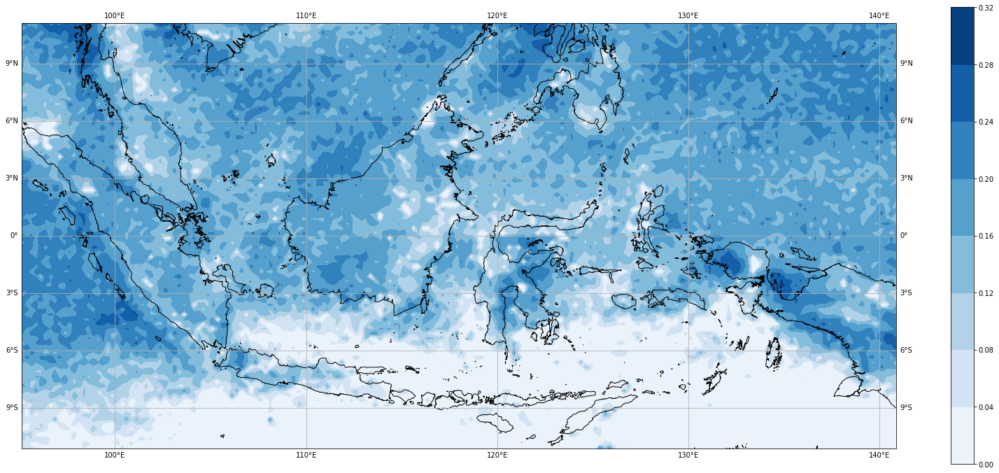

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,AGU20_50,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

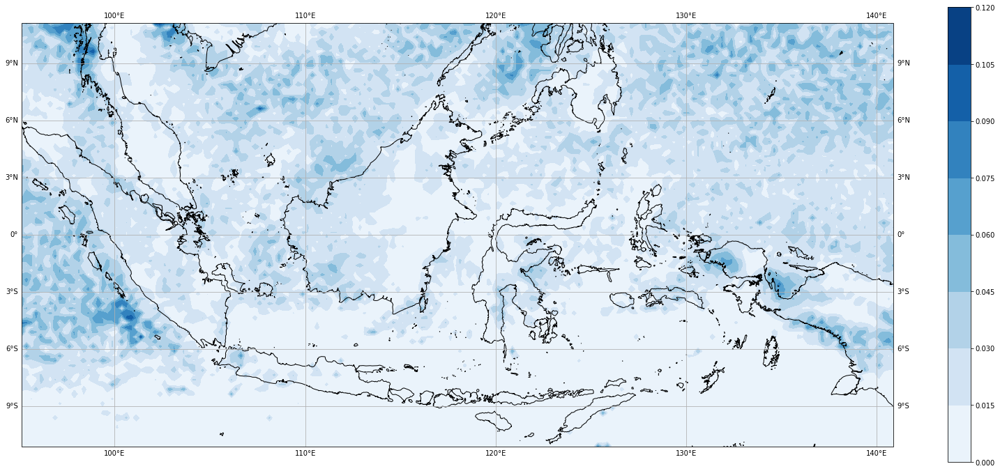

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,AGU50_100,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

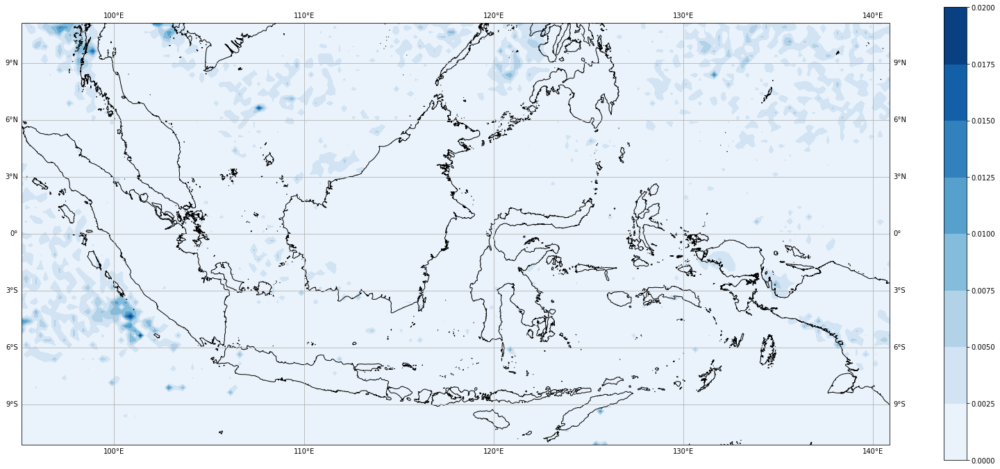

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,AGU100_150,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

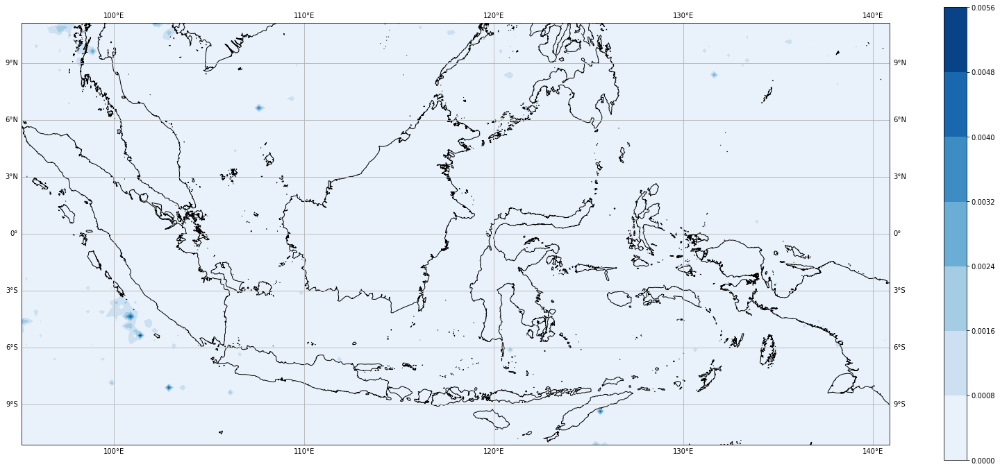

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,AGU150,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

# **September**

In [ ]:
SEP05_20=np.zeros((90,184))
SEP20_50=np.zeros((90,184))
SEP50_100=np.zeros((90,184))
SEP100_150=np.zeros((90,184))
SEP150=np.zeros((90,184))

for iy in (range(0,90)):
  for ix in range (0,184):
    TS=Indonesia[:,iy,ix] 
    TS=TS.groupby('time.month') 
    for imon in range(9,10): 
      TSmon=TS[imon].dropna('time') 
      gampar=st.gamma.fit(TSmon.data[TSmon.data<80])
      #probabilitas 0.5<CH<20
      ao=st.gamma.cdf(20,*gampar) - st.gamma.cdf(0.5,*gampar)
      SEP05_20[iy,ix]=ao
      #probabilitas 20<CH<50
      ap=st.gamma.cdf(50,*gampar)-st.gamma.cdf(20,*gampar)
      SEP20_50[iy,ix]=ap
      #prob 50<CH<100
      aq=st.gamma.cdf(100,*gampar)-st.gamma.cdf(50,*gampar)
      SEP50_100[iy,ix]=aq
      #prob 100<CH<150
      ar=st.gamma.cdf(150,*gampar)-st.gamma.cdf(100,*gampar)
      SEP100_150[iy,ix]=ar
      #prob CH >150
      at= 1-st.gamma.cdf(150,*gampar)
      SEP150[iy,ix]=at

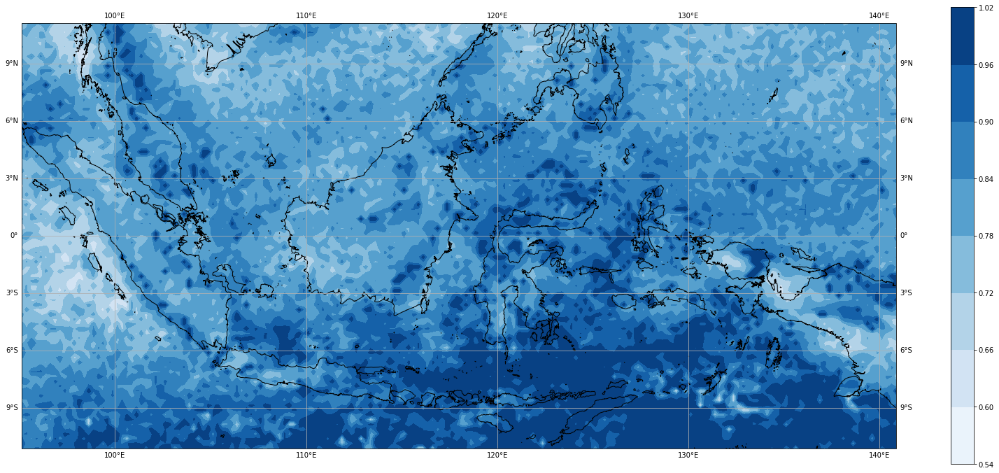

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,SEP05_20,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

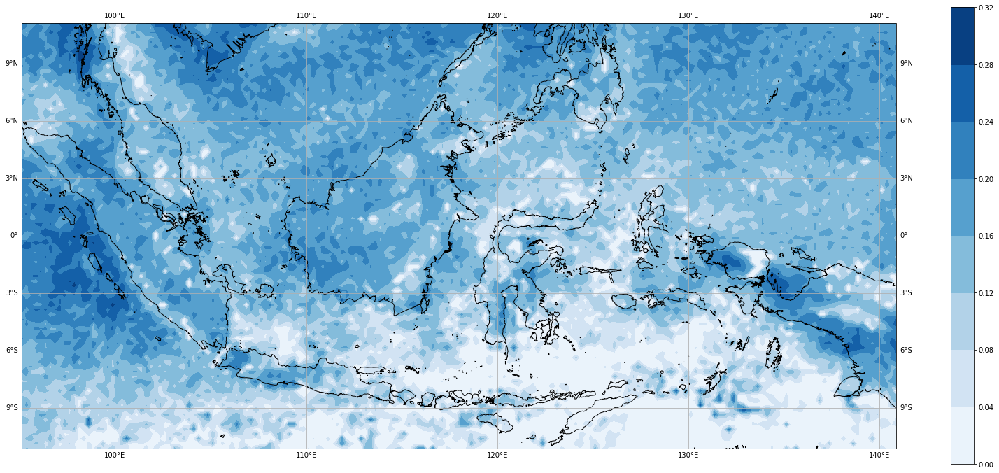

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,SEP20_50,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

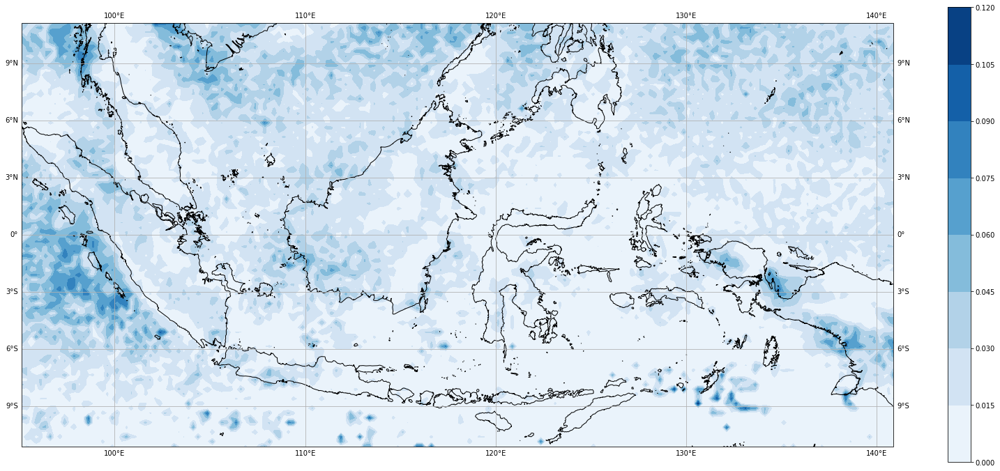

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,SEP50_100,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

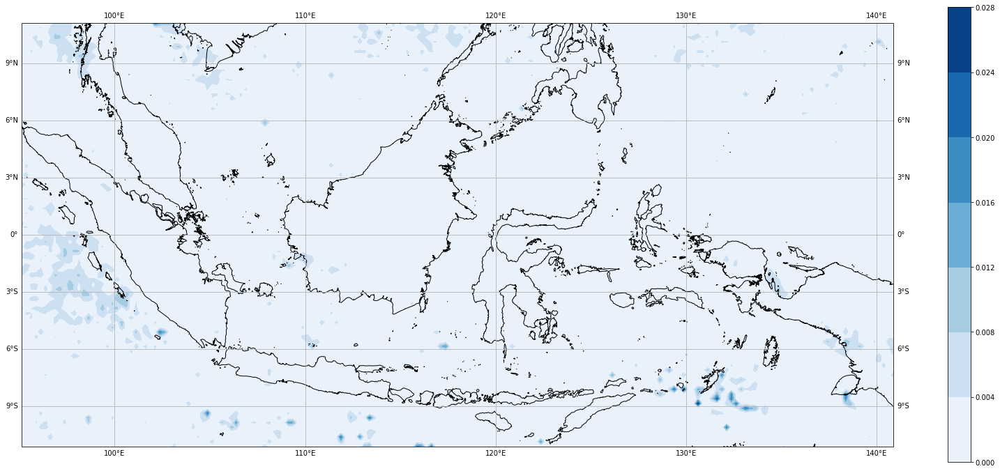

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,SEP100_150,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

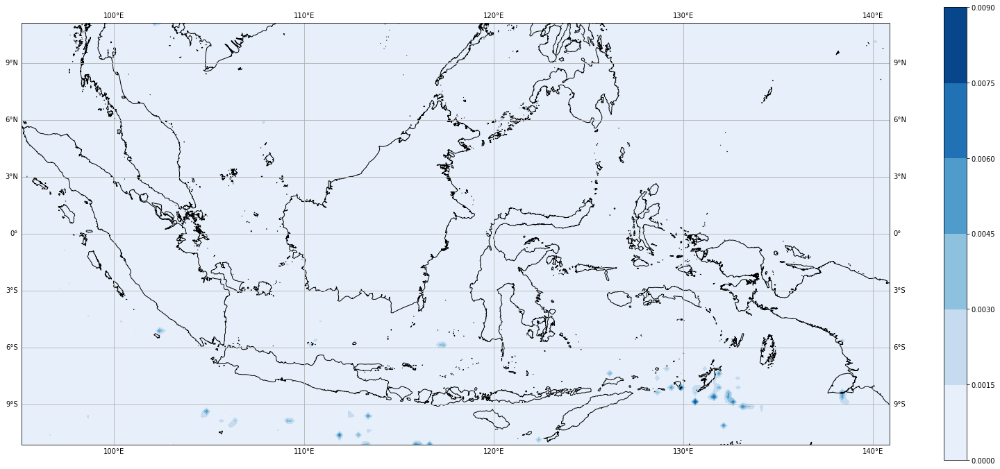

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,SEP150,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

# **Oktober**

In [ ]:
OKT05_20=np.zeros((90,184))
OKT20_50=np.zeros((90,184))
OKT50_100=np.zeros((90,184))
OKT100_150=np.zeros((90,184))
OKT150=np.zeros((90,184))

for iy in (range(0,90)):
  for ix in range (0,184):
    TS=Indonesia[:,iy,ix] 
    TS=TS.groupby('time.month') 
    for imon in range(10,11): 
      TSmon=TS[imon].dropna('time') 
      gampar=st.gamma.fit(TSmon.data[TSmon.data<80])
      #probabilitas 0.5<CH<20
      au=st.gamma.cdf(20,*gampar) - st.gamma.cdf(0.5,*gampar)
      OKT05_20[iy,ix]=au
      #probabilitas 20<CH<50
      av=st.gamma.cdf(50,*gampar)-st.gamma.cdf(20,*gampar)
      OKT20_50[iy,ix]=av
      #prob 50<CH<100
      aw=st.gamma.cdf(100,*gampar)-st.gamma.cdf(50,*gampar)
      OKT50_100[iy,ix]=aw
      #prob 100<CH<150
      ay=st.gamma.cdf(150,*gampar)-st.gamma.cdf(100,*gampar)
      OKT100_150[iy,ix]=ay
      #prob CH >150
      az= 1-st.gamma.cdf(150,*gampar)
      OKT150[iy,ix]=az

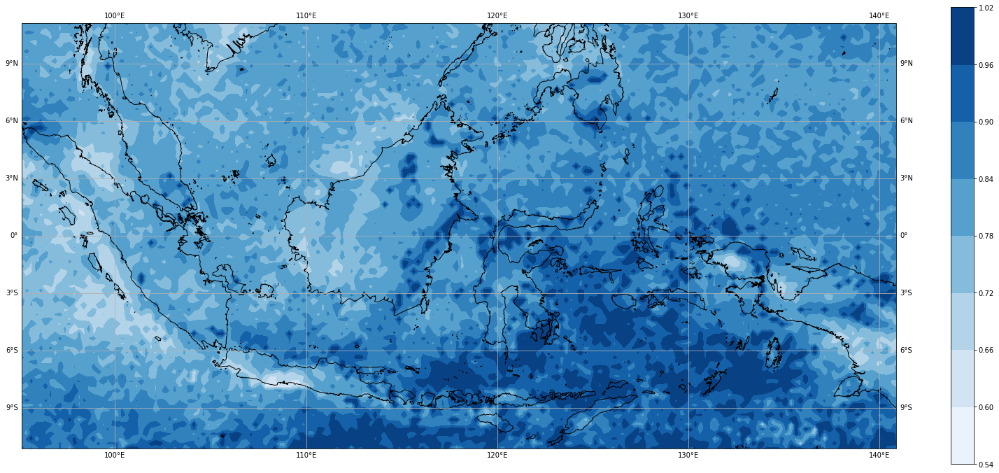

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,OKT05_20,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

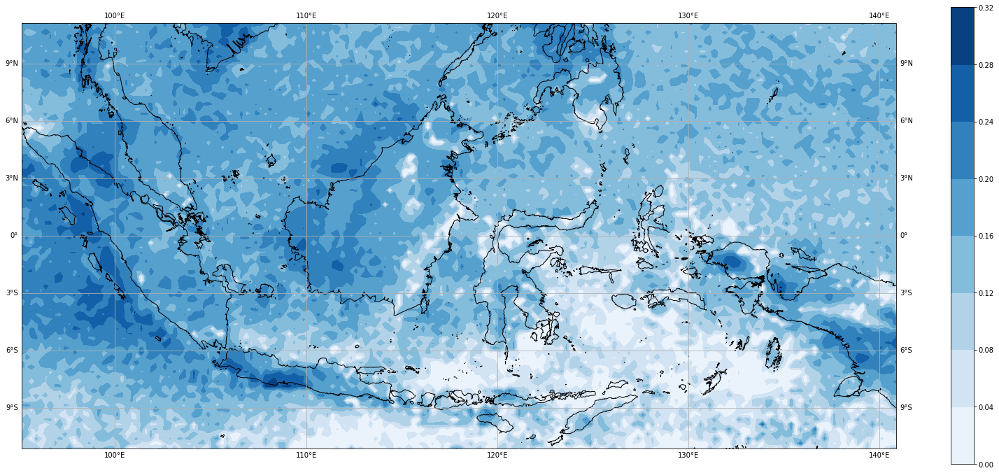

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,OKT20_50,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

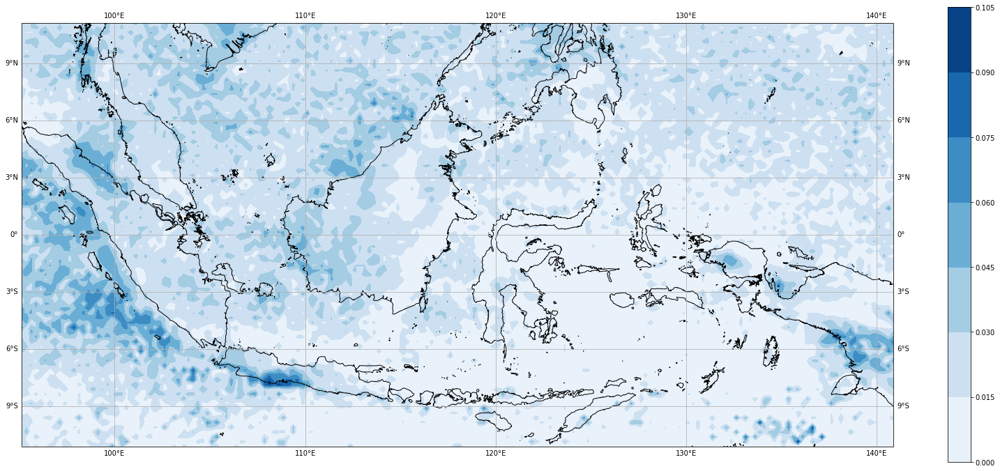

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,OKT50_100,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

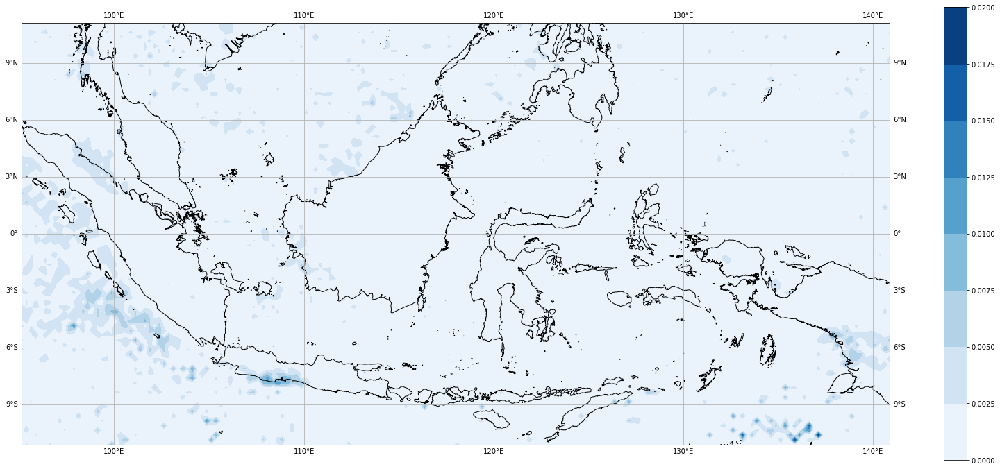

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,OKT100_150,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

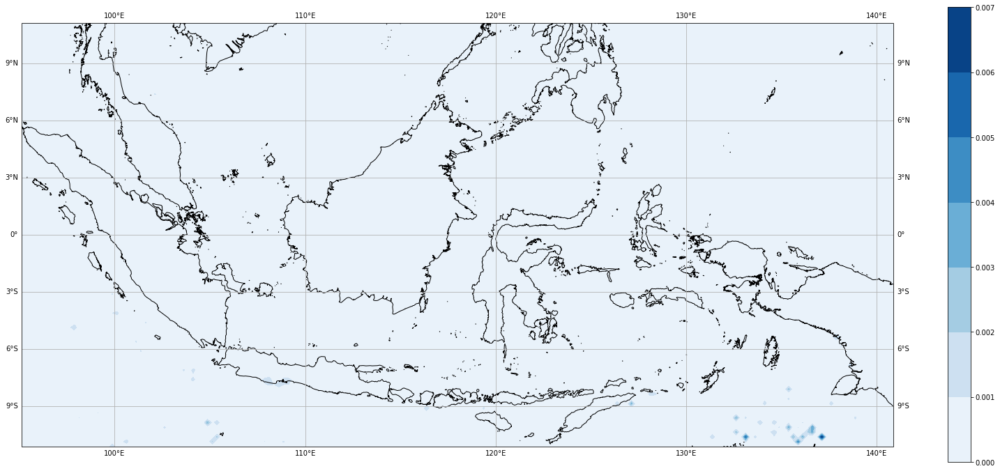

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,OKT150,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

# **November**

In [ ]:
NOV05_20=np.zeros((90,184))
NOV20_50=np.zeros((90,184))
NOV50_100=np.zeros((90,184))
NOV100_150=np.zeros((90,184))
NOV150=np.zeros((90,184))

for iy in (range(0,90)):
  for ix in range (0,184):
    TS=Indonesia[:,iy,ix] 
    TS=TS.groupby('time.month') 
    for imon in range(11,12): 
      TSmon=TS[imon].dropna('time') 
      gampar=st.gamma.fit(TSmon.data[TSmon.data<80])
      #probabilitas 0.5<CH<20
      ba=st.gamma.cdf(20,*gampar) - st.gamma.cdf(0.5,*gampar)
      NOV05_20[iy,ix]=ba
      #probabilitas 20<CH<50
      bb=st.gamma.cdf(50,*gampar)-st.gamma.cdf(20,*gampar)
      NOV20_50[iy,ix]=bb
      #prob 50<CH<100
      bc=st.gamma.cdf(100,*gampar)-st.gamma.cdf(50,*gampar)
      NOV50_100[iy,ix]=bc
      #prob 100<CH<150
      bd=st.gamma.cdf(150,*gampar)-st.gamma.cdf(100,*gampar)
      NOV100_150[iy,ix]=bd
      #prob CH >150
      be= 1-st.gamma.cdf(150,*gampar)
      NOV150[iy,ix]=be

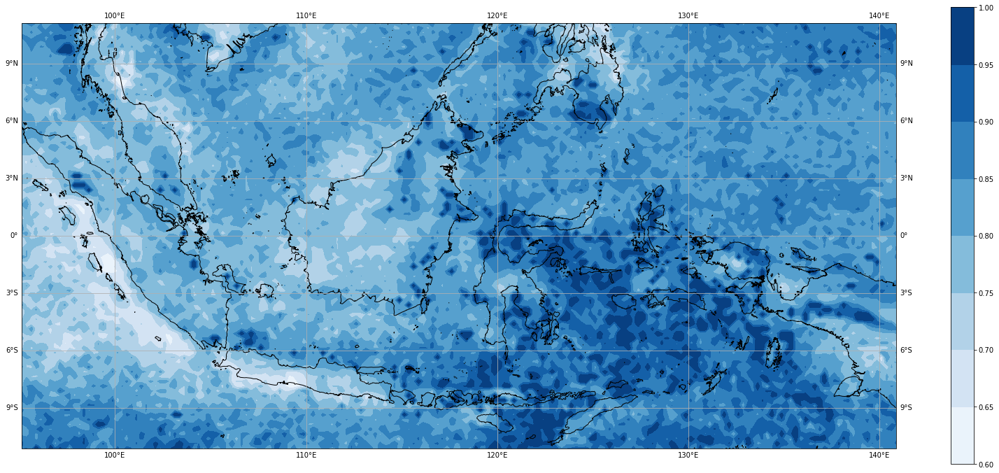

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,NOV05_20,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

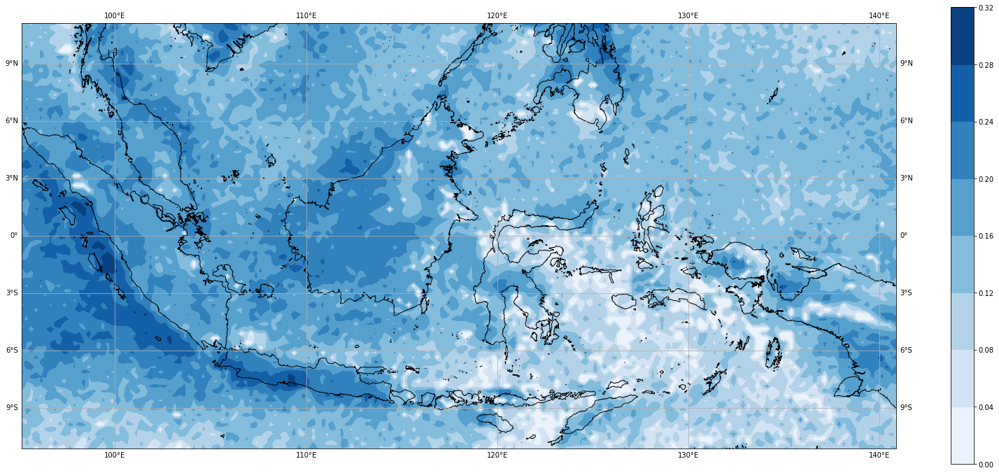

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,NOV20_50,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

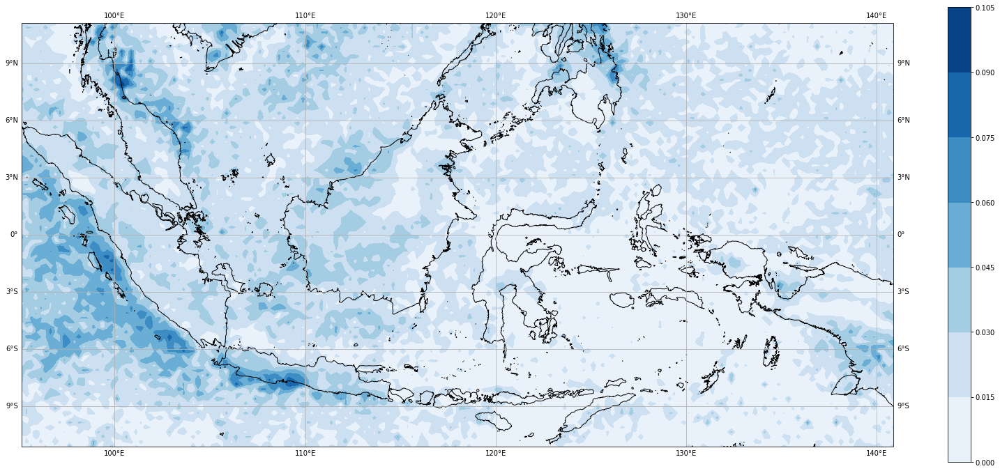

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,NOV50_100,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

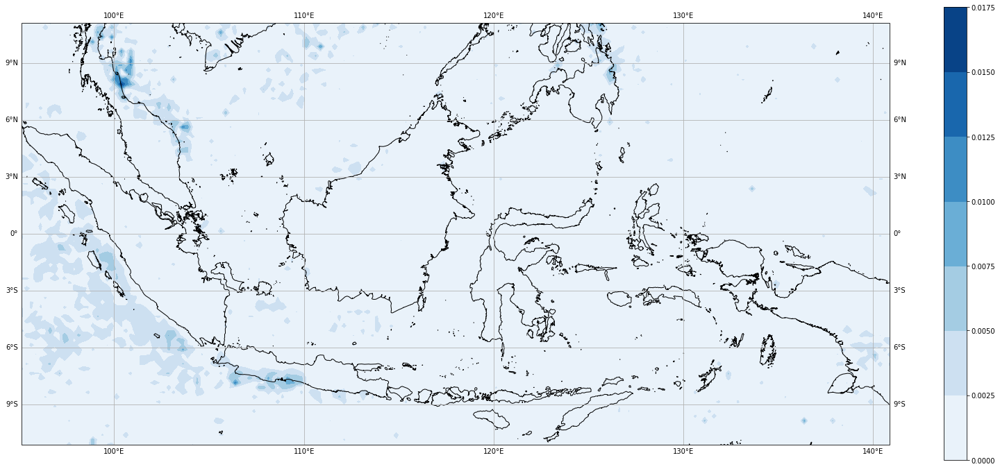

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,NOV100_150,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

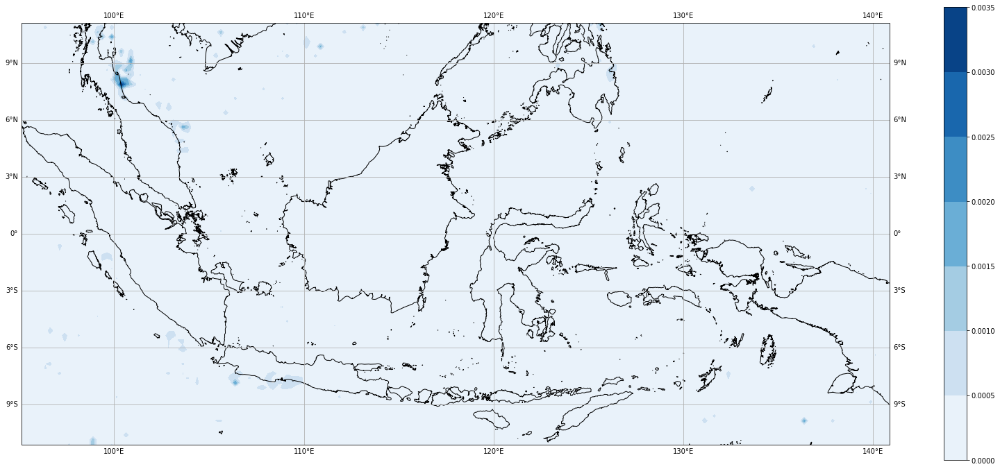

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,NOV150,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

# **Desember**

In [ ]:
DES05_20=np.zeros((90,184))
DES20_50=np.zeros((90,184))
DES50_100=np.zeros((90,184))
DES100_150=np.zeros((90,184))
DES150=np.zeros((90,184))

for iy in (range(0,90)):
  for ix in range (0,184):
    TS=Indonesia[:,iy,ix] 
    TS=TS.groupby('time.month') 
    for imon in range(12,13): 
      TSmon=TS[imon].dropna('time') 
      gampar=st.gamma.fit(TSmon.data[TSmon.data<80])
      #probabilitas 0.5<CH<20
      bf=st.gamma.cdf(20,*gampar) - st.gamma.cdf(0.5,*gampar)
      DES05_20[iy,ix]=bf
      #probabilitas 20<CH<50
      bg=st.gamma.cdf(50,*gampar)-st.gamma.cdf(20,*gampar)
      DES20_50[iy,ix]=bg
      #prob 50<CH<100
      bh=st.gamma.cdf(100,*gampar)-st.gamma.cdf(50,*gampar)
      DES50_100[iy,ix]=bh
      #prob 100<CH<150
      bi=st.gamma.cdf(150,*gampar)-st.gamma.cdf(100,*gampar)
      DES100_150[iy,ix]=bi
      #prob CH >150
      bj= 1-st.gamma.cdf(150,*gampar)
      DES150[iy,ix]=bj

/usr/local/lib/python3.7/dist-packages/cartopy/io/__init__.py:241: DownloadWarning: Downloading: https://www.ngdc.noaa.gov/mgg/shorelines/data/gshhs/oldversions/version2.2.0/GSHHS_shp_2.2.0.zip
  warnings.warn('Downloading: {}'.format(url), DownloadWarning)
/usr/local/lib/python3.7/dist-packages/shapefile.py:391: UserWarning: Shapefile shape has invalid polygon: no exterior rings found (must have clockwise orientation); interpreting holes as exteriors.
  warnings.warn('Shapefile shape has invalid polygon: no exterior rings found (must have clockwise orientation); interpreting holes as exteriors.')


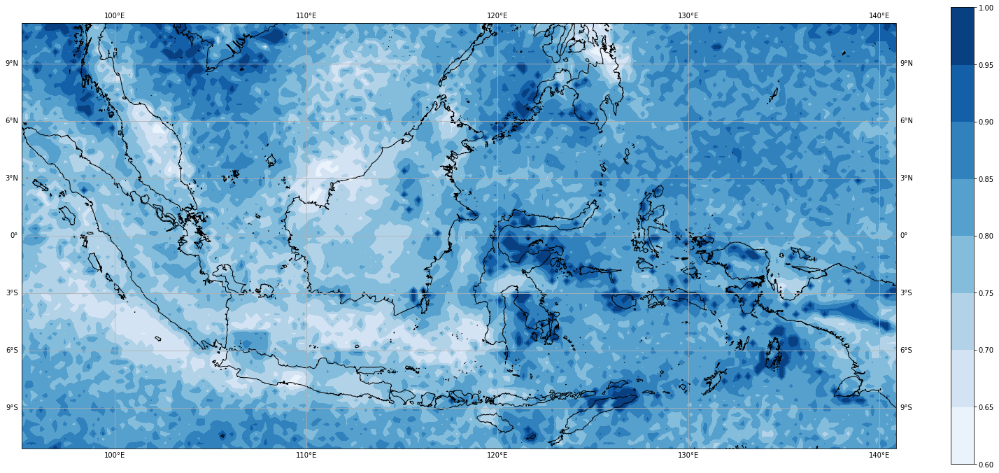

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,DES05_20,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

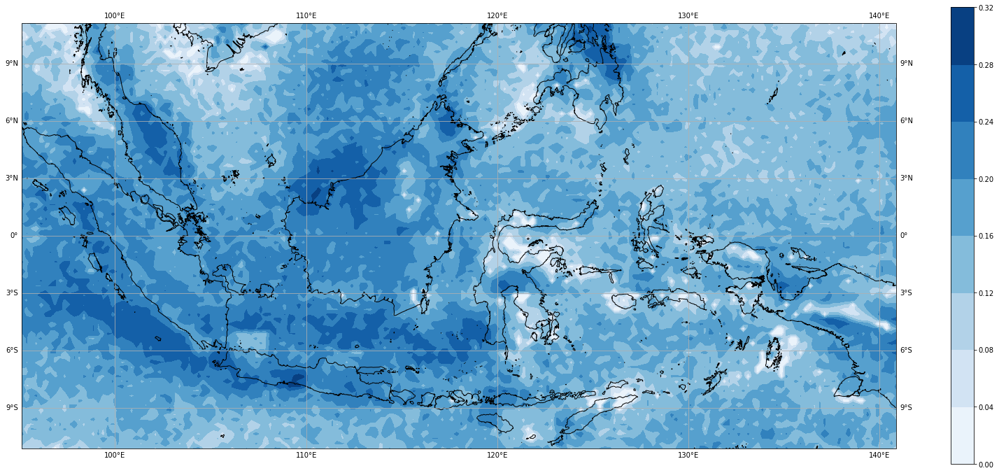

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,DES20_50,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

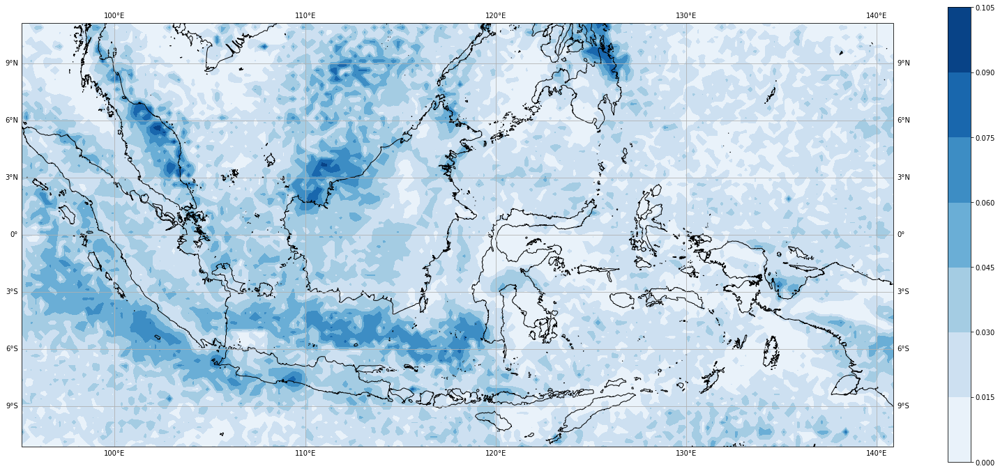

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,DES50_100,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

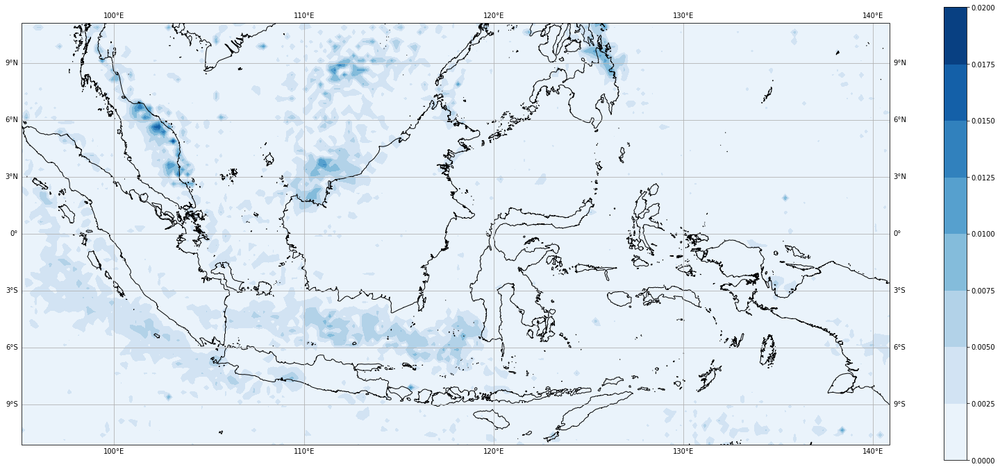

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,DES100_150,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline

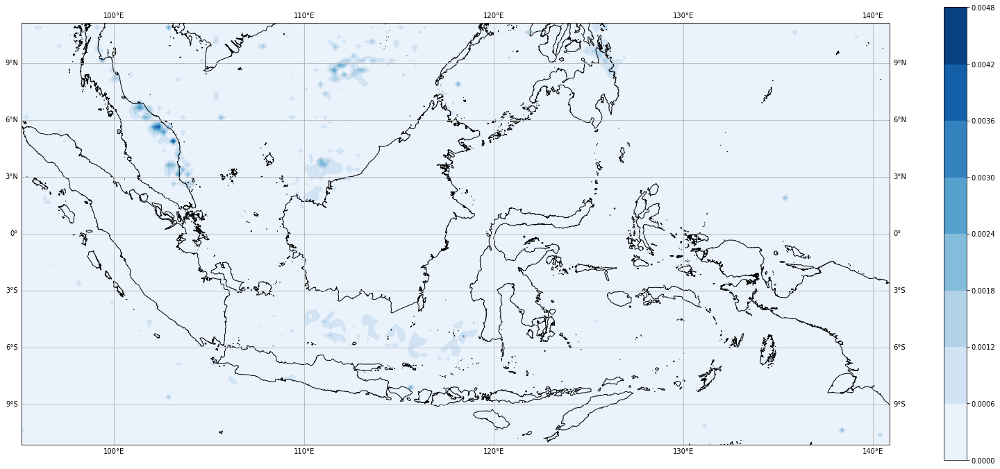

In [ ]:
import cartopy.crs as ccrs #untuk menentukan proyeksi peta (Coordinate Reference System)
import cartopy.feature as cfeature #untuk menambahkan fitur pada peta

#1. Tentukan proyeksi peta yang akan dipakai
mproj=ccrs.PlateCarree()
#2. Buat figure dan axis
fig = plt.figure(figsize=(28,12))
ax = plt.axes(projection=mproj)
#3. Buat konturnya dengan meproyeksikan data raster (matriks 2D) ke proyeksi peta
cf=ax.contourf(Indonesia.lon,Indonesia.lat,DES150,  # lon, lat, data
               cmap=plt.cm.Blues, #colormap
               transform=mproj)  #transformasi data ke proyeksi peta
cb = plt.colorbar(cf) #colorbar
#4. Tambahkan beberapa fitur peta
ax.add_feature(cfeature.GSHHSFeature(scale='intermediate')) #coastline, menggunakan data GSHHS dengan resolusi 'intermediate'
ax.gridlines(draw_labels=True) #gridline